## IGO14143 - Slc4a11-MCD lineage tracing 2 weeks - 10k
3/8/2023 - Data generated from Slc4a11-MCD mice lineage traced for 2 weeks; data submitted by Jason/Chun-Hao/Hannah on 1/18/23; fixed cells at 10k Analyze global run on cellranger v6 data and create h5_ad files for further analysis

8/25/2025 - Rerun with latest installed libraries to ensure coherence

Slc4a11-MCD Hipp11-GGCB, AdSpc-FlpO, 16 weeks post tumor initiation, traced for two weeks. CellRanger run with fixed 10k cells due to quality issues

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib
from matplotlib import pyplot as plt

import anndata
from pathlib import Path


In [2]:
# Set plot parameters to help with exports
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [4]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [5]:
results_file = 'write/IGO14143-slc4a11-traced.h5ad'  # the file that will store the analysis results

In [6]:
adata = sc.read_10x_h5('GSE277777_IGO14143-filtered_feature_bc_matrix_10k.h5', gex_only=False)

reading GSE277777_IGO14143-filtered_feature_bc_matrix_10k.h5
 (0:00:02)


/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [7]:
adata.var_names_make_unique()

In [8]:
#Fix incorrect mTagBFP2 naming
adata.var_names = adata.var_names.str.replace('mTagBFP2', 'tagBFP')

In [9]:
samples = list(adata[:,adata.var['feature_types']=='Antibody Capture'].var.index)

In [10]:
print(samples)

['AV1975_mscarlet_B0302', 'AV1975_bfp_B0304', 'AV1975_gfp_mscarlet_B0305', 'AV1980_mscarlet_B0306', 'AV1980_bfp_B0309', 'AV1980_gfp_mscarlet_B0310']


In [11]:
# Now select out barcodes
hashadata = adata[:,samples]
adata = adata[:,[y for y in adata.var_names if y not in samples]]

In [12]:
hashadata.var

,gene_ids,feature_types,genome,pattern,read,sequence
AV1975_mscarlet_B0302,AV1975_mscarlet,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,GGTCGAGAGCATTCA
AV1975_bfp_B0304,AV1975_bfp,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,AAAGCATTCTTCACG
AV1975_gfp_mscarlet_B0305,AV1975_gfp_mscarlet,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CTTTGTCTTTGTGAG
AV1980_mscarlet_B0306,AV1980_mscarlet,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATGCTGCCACGGTA
AV1980_bfp_B0309,AV1980_bfp,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TGCCTATGAAACAAG
AV1980_gfp_mscarlet_B0310,AV1980_gfp_mscarlet,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CCGATTGTAACAGAC


## Preprocessing

Show those genes that yield the highest fraction of counts in each single cell, across all cells.

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


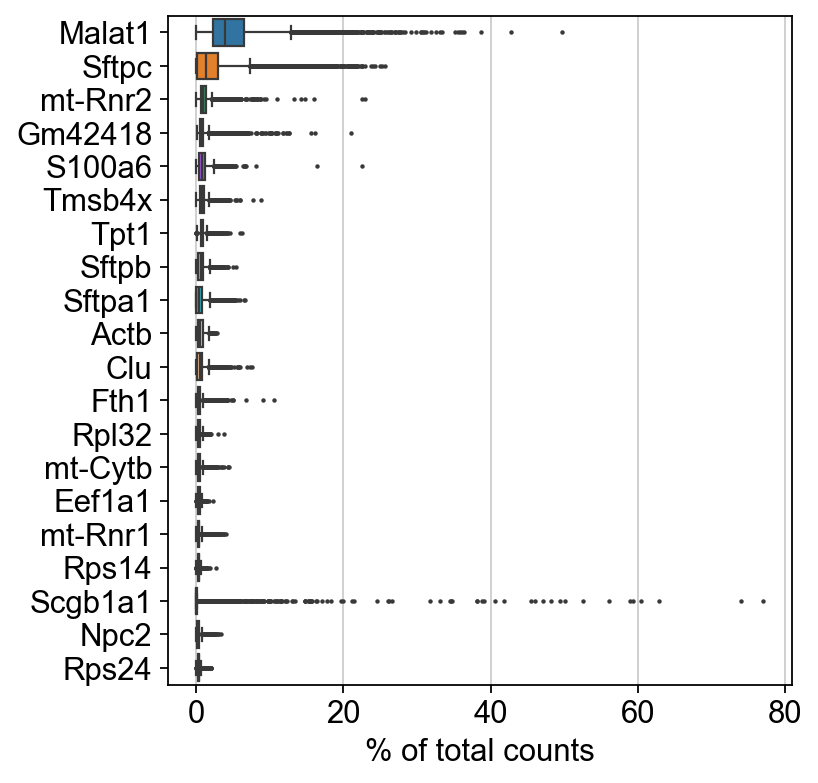

In [13]:
sc.pl.highest_expr_genes(adata, n_top=20, )

Basic filtering:

In [14]:
sc.pp.filter_cells(adata, min_counts=1500)
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 28712 genes that are detected in less than 3 cells


In [15]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

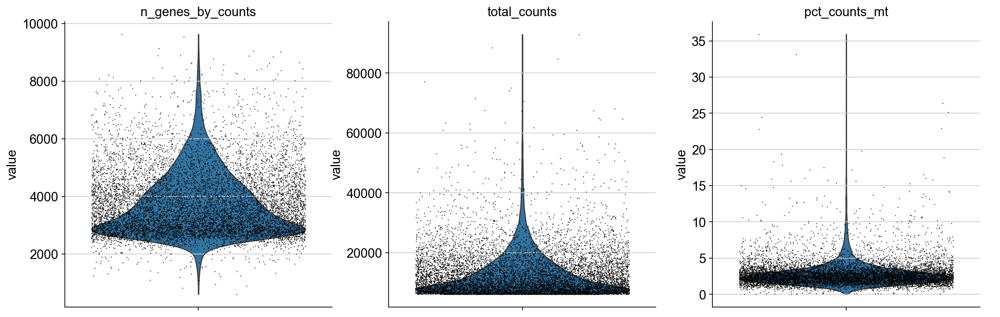

In [16]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([3.000e+00, 3.000e+00, 2.500e+01, 1.900e+01, 6.800e+01, 2.820e+02,
        1.407e+03, 3.191e+03, 3.847e+03, 1.155e+03]),
 array([0.72725325, 0.74617994, 0.76510664, 0.78403334, 0.80296004,
        0.82188674, 0.84081343, 0.85974013, 0.87866683, 0.89759353,
        0.91652022]),
 <BarContainer object of 10 artists>)

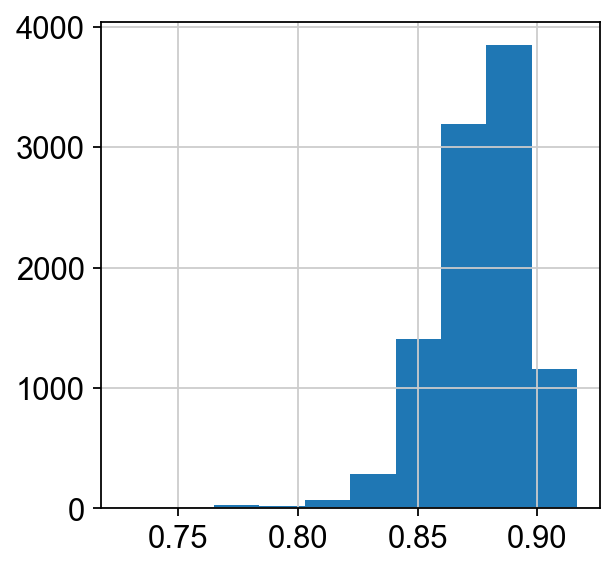

In [17]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

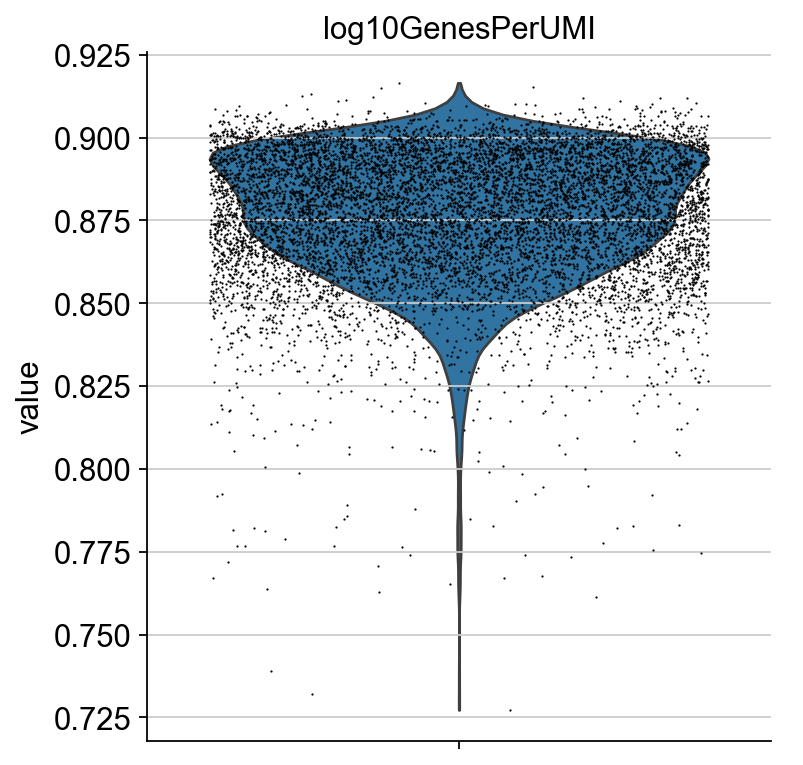

In [18]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)

In [19]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.8,:]
adata = adata[adata.obs.pct_counts_mt <= 10, :]

## Run Demultiplexing

In [20]:
hashadata = hashadata[hashadata.obs.index.isin(adata.obs.index), :]

In [21]:
hashadata.var_names

Index(['AV1975_mscarlet_B0302', 'AV1975_bfp_B0304',
       'AV1975_gfp_mscarlet_B0305', 'AV1980_mscarlet_B0306',
       'AV1980_bfp_B0309', 'AV1980_gfp_mscarlet_B0310'],
      dtype='object')

In [22]:
hashCounts = pd.DataFrame(hashadata.X.todense(), columns=hashadata.var_names, index=adata.obs.index)

In [23]:
# setup a naive hash threshold
hashDisc = hashCounts.describe([.1,.2,.3,.4,.5,.6,.7,.8,.9])

In [24]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(hashDisc.loc["90%",hashName])
    hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]

AV1975_mscarlet_B0302
338.0
AV1975_bfp_B0304
85.0
AV1975_gfp_mscarlet_B0305
1135.7000000000007
AV1980_mscarlet_B0306
363.7000000000007
AV1980_bfp_B0309
270.7000000000007
AV1980_gfp_mscarlet_B0310
846.7000000000007


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/1364827477.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/1364827477.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/1364827477.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise 

In [25]:
hashCounts

,AV1975_mscarlet_B0302,AV1975_bfp_B0304,AV1975_gfp_mscarlet_B0305,AV1980_mscarlet_B0306,AV1980_bfp_B0309,AV1980_gfp_mscarlet_B0310
AAACCCAAGATCGGTG-1,39.0,25.0,50.0,37.0,21.0,4026.0
AAACCCAAGATGTTAG-1,38.0,12.0,44.0,27.0,2649.0,48.0
AAACCCAAGCACACCC-1,63.0,23.0,192.0,67.0,88.0,131.0
AAACCCAAGCTGGTGA-1,126.0,14.0,50.0,26.0,21.0,48.0
AAACCCAAGTATAGGT-1,73.0,9.0,115.0,47.0,55.0,72.0
...,...,...,...,...,...,...
TTTGTTGCATGACGTT-1,59.0,28.0,128.0,60.0,67.0,84.0
TTTGTTGCATGGCACC-1,80.0,17.0,55.0,43.0,17.0,75.0
TTTGTTGGTCCACTCT-1,205.0,47.0,948.0,371.0,204.0,819.0
TTTGTTGGTCTATGAC-1,75.0,10.0,119.0,25.0,14.0,51.0


In [26]:
plt.rcParams['figure.figsize'] = (3,4)

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/sklearn/mixture/_base.py:275: ConvergenceWarning: Best performing initialization did not converge. Try different init parameters, or increase max_iter, tol, or check for degenerate data.
  warnings.warn(


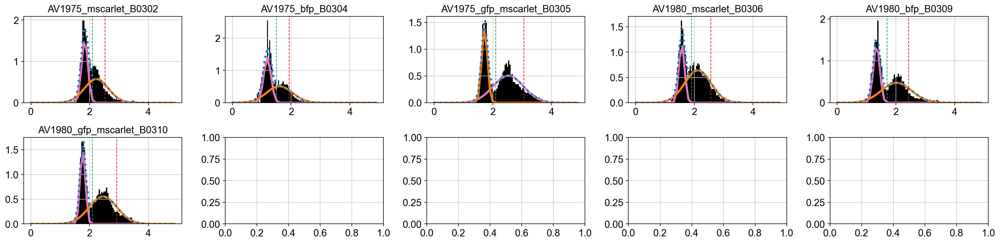

In [27]:
# Setup BayesianGMM to determine hash threshold
from sklearn.mixture import BayesianGaussianMixture
from scipy.stats import norm
fig, axs = plt.subplots(2,5, figsize =(20, 5))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
gmm = BayesianGaussianMixture(n_components=2, random_state=250,init_params='k-means++')
binEx = np.arange(0,5,5/100).reshape(-1,1)

for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log10(hashCounts[hashName]+1)).reshape(-1, 1)
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_
  
    fitGmmBound = fitGMM.predict(binEx)

    x_axis = np.arange(0, 5, 0.1)
    y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
    y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian

    hashBoundry = False #binEx[np.where(fitGmmBound == 1)[0][0]][0]    
    if mean[0][0] < mean[1][0]:
        hashBoundry = x_axis[np.where(y_axis1 < y_axis0)[0][-1]+2]
    else:
        hashBoundry = x_axis[np.where(y_axis0 < y_axis1)[0][-1]+2]
    
    naiveBoundry = np.log10(int(hashDisc.loc["90%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    # Plot 2
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red
    axs[i//5,i%5].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green
    axs[i//5,i%5].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//5,i%5].plot(x_axis, y_axis0, lw=3, c='C6')                            #pink
    axs[i//5,i%5].plot(x_axis, y_axis1, lw=3, c='C1')                            #orange
    axs[i//5,i%5].plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

In [28]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(dfHashBoundry.loc[hashName].values[0])
    hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
#hashIDs

AV1975_mscarlet_B0302
2.1
AV1975_bfp_B0304
1.5
AV1975_gfp_mscarlet_B0305
2.1
AV1980_mscarlet_B0306
1.9000000000000001
AV1980_bfp_B0309
1.7000000000000002
AV1980_gfp_mscarlet_B0310
2.1


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/416796475.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ...  True False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/416796475.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ...  True False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/416796475.py:6: FutureWarning: Setting an item of incompati

In [29]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [30]:
adata.obs["Classification"] = classification
hashadata.obs["Classification"] = classification
adata.obs["Classification"].value_counts()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/4135005838.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["Classification"] = classification
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/4135005838.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  hashadata.obs["Classification"] = classification


Classification
doublet                      5555
AV1980_mscarlet_B0306        1075
AV1980_gfp_mscarlet_B0310     745
AV1975_gfp_mscarlet_B0305     714
negative                      696
AV1975_mscarlet_B0302         509
AV1980_bfp_B0309              465
AV1975_bfp_B0304              105
Name: count, dtype: int64

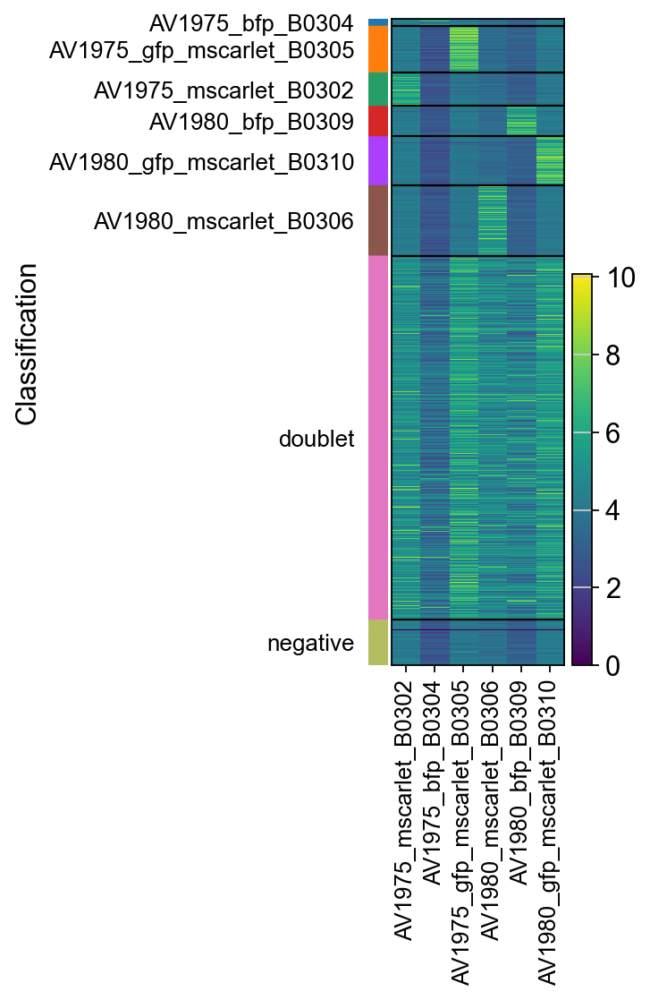

In [31]:
#output visulaization of hashing
sc.pl.heatmap(hashadata, hashadata.var_names, groupby="Classification", log=True)#, save = f"_{figName}_hash.png")

## Filter doublets and negative cells

In [32]:
adata.obs.Classification.value_counts()

Classification
doublet                      5555
AV1980_mscarlet_B0306        1075
AV1980_gfp_mscarlet_B0310     745
AV1975_gfp_mscarlet_B0305     714
negative                      696
AV1975_mscarlet_B0302         509
AV1980_bfp_B0309              465
AV1975_bfp_B0304              105
Name: count, dtype: int64

In [33]:
adata = adata[~adata.obs['Classification'].isin(['doublet','negative']),:]

In [34]:
adata.obs.Classification.value_counts()

Classification
AV1980_mscarlet_B0306        1075
AV1980_gfp_mscarlet_B0310     745
AV1975_gfp_mscarlet_B0305     714
AV1975_mscarlet_B0302         509
AV1980_bfp_B0309              465
AV1975_bfp_B0304              105
Name: count, dtype: int64

## Set Groups

In [35]:
samples

['AV1975_mscarlet_B0302',
 'AV1975_bfp_B0304',
 'AV1975_gfp_mscarlet_B0305',
 'AV1980_mscarlet_B0306',
 'AV1980_bfp_B0309',
 'AV1980_gfp_mscarlet_B0310']

In [36]:
#Set groups, note BFP sorting was liberal
adata.obs['Group'] = 'mScarlet+'
adata.obs['Group'][adata.obs.Classification.isin(['AV1975_bfp_B0304','AV1975_bfp_B0304'])] = 'BFP+'
adata.obs['Group'][adata.obs.Classification.isin(['AV1975_gfp_mscarlet_B0305','AV1980_gfp_mscarlet_B0310'])] = 'mScarlet-'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/1811496236.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['Group'] = 'mScarlet+'
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/1811496236.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation:

## Preprocess data

In [37]:
adata.layers['counts']=adata.X.copy()

In [38]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [39]:
sc.pp.log1p(adata)

In [40]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


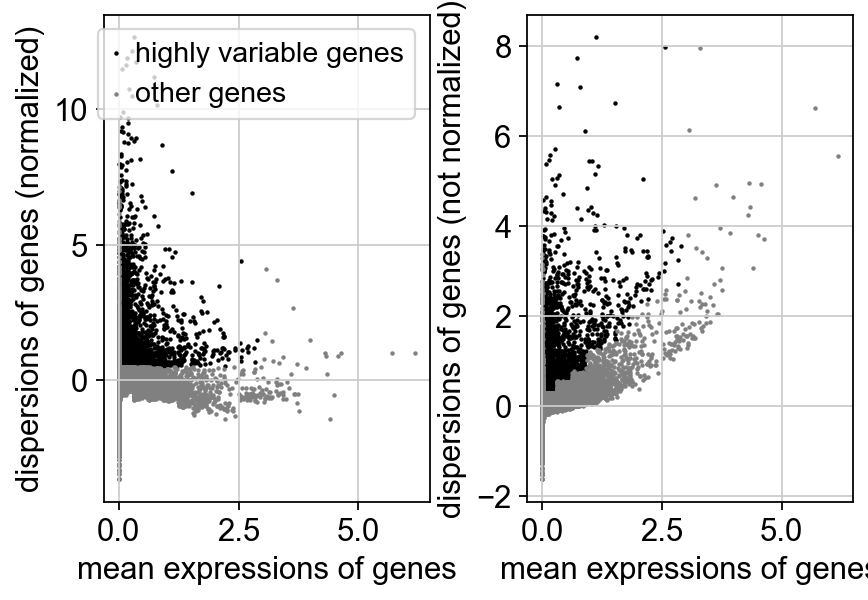

In [41]:
sc.pl.highly_variable_genes(adata)

In [42]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['tagBFP'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/850513103.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/8505131

In [43]:
adata.write('write/allmice-IGO14143.h5ad', compression='gzip')

In [44]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [45]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


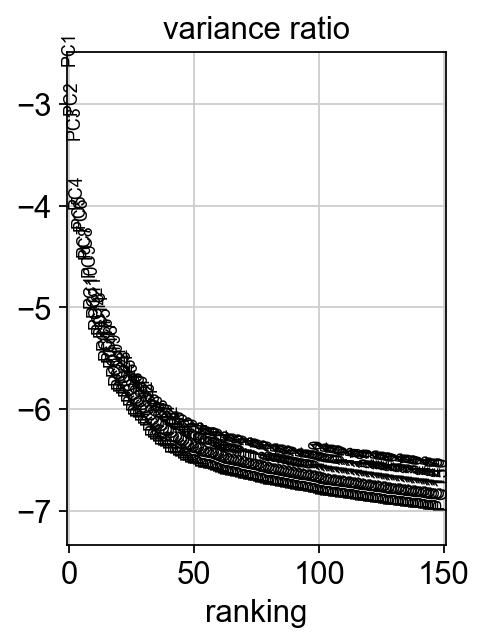

In [46]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

In [47]:
adata.write(results_file, compression='gzip')

## Compute the neighborhood graph

In [48]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)


## Embed the neighborhood graph

In [49]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:08)


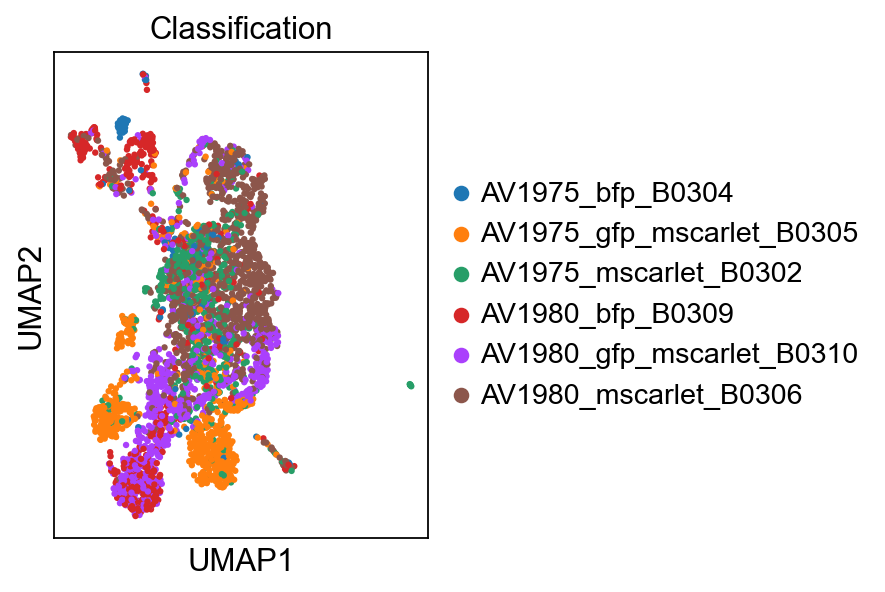

In [50]:
sc.pl.umap(adata, color=['Classification'])

In [51]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['tagBFP'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/850513103.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/8505131

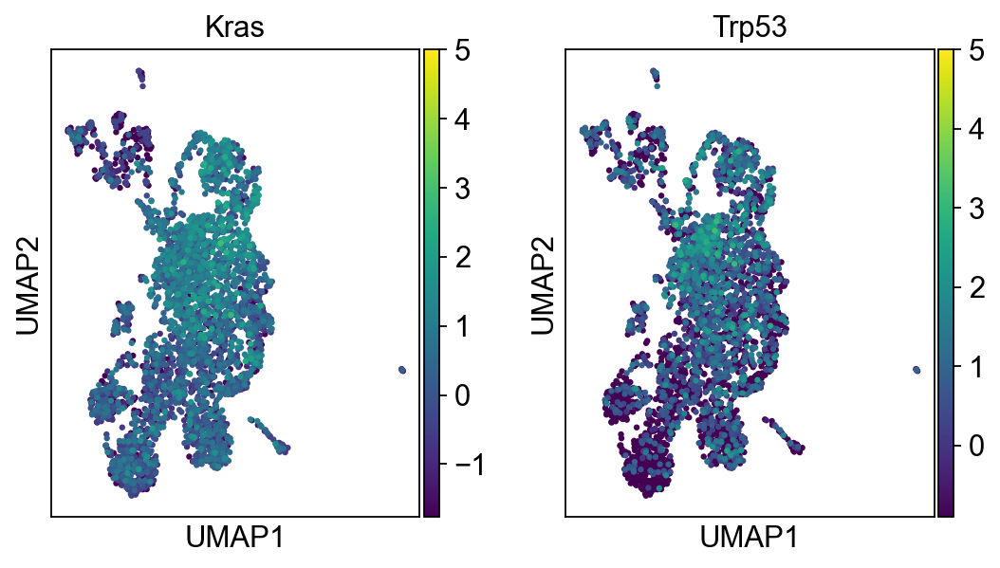

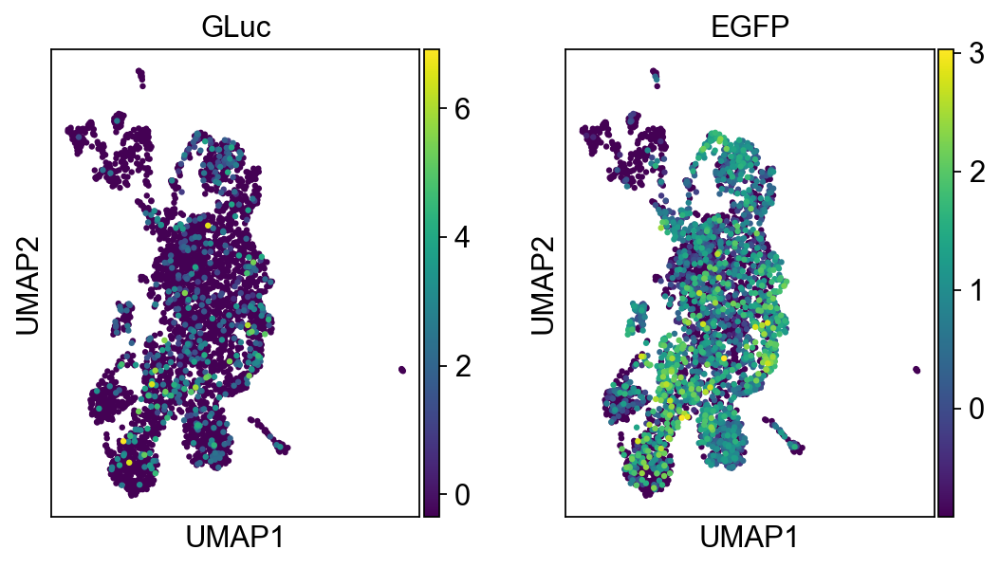

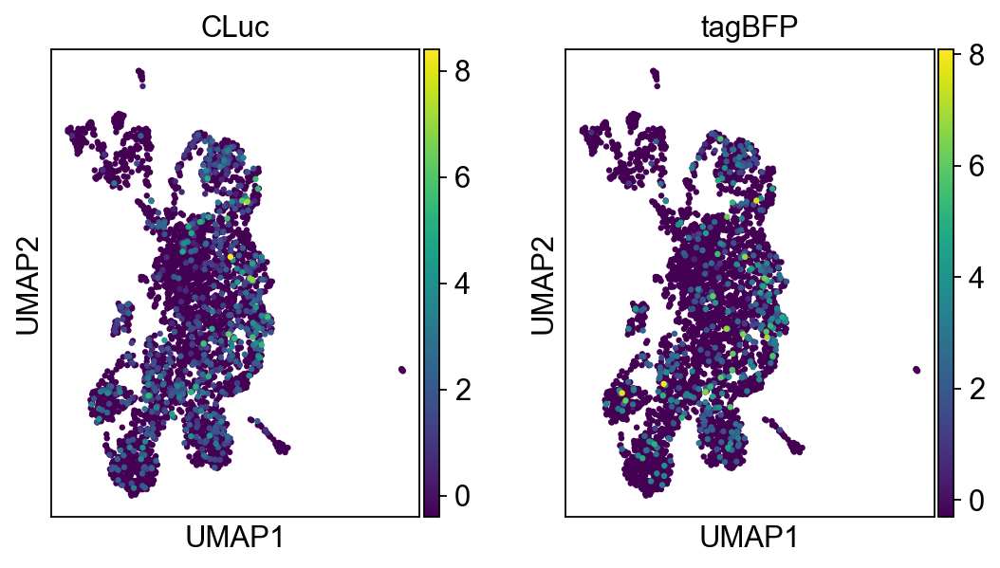

In [52]:
sc.pl.umap(adata, color=['Kras','Trp53'], vmax=5)
sc.pl.umap(adata, color=['GLuc','EGFP'])
sc.pl.umap(adata, color=['CLuc','tagBFP'])

## Define scoring Functions

In [53]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [54]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [55]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1790 total control genes are used. (0:00:01)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1392 total control genes are used. (0:00:01)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1690 total control genes are used. (0:00:01)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1696 total control genes are used. (0:00:01)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1687 total control genes are used. (0:00:01)
computing score 'Cluster 6'
       'Gm10179', 'Ldha-ps2'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    2097 total control genes are used. (0:00:01)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gen

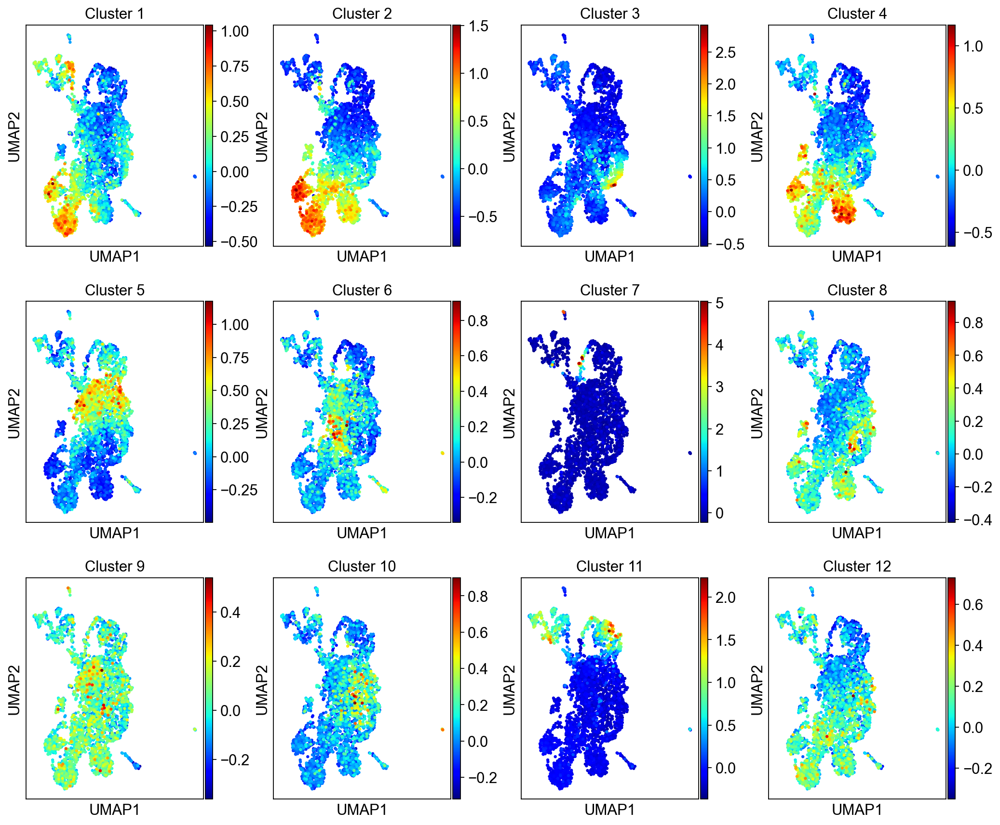

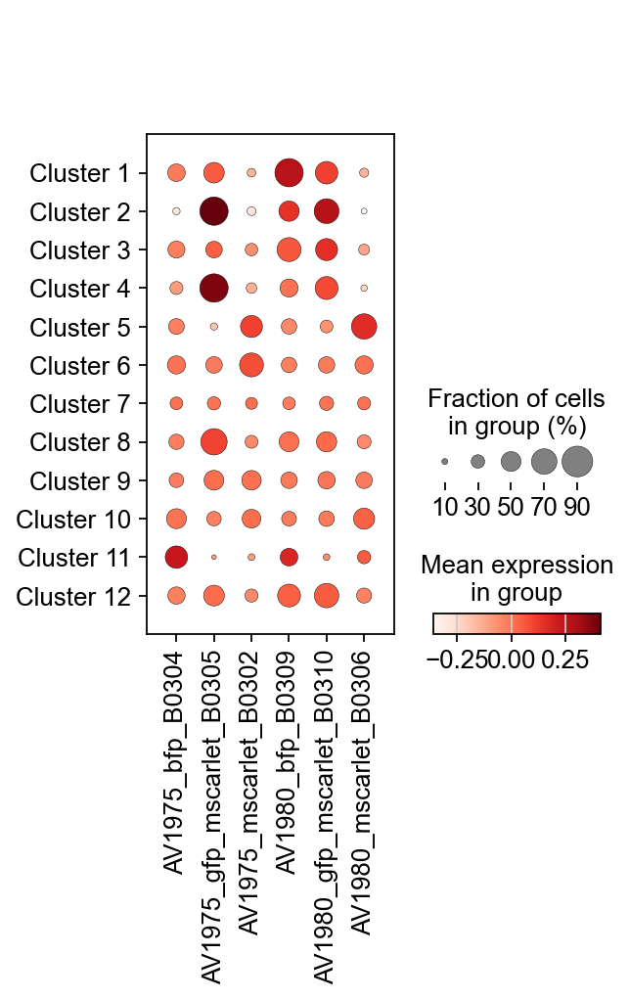

In [56]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

In [57]:
sc.tl.leiden(adata, resolution=.5)

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/3189315767.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=.5)


Plot the clusters, which agree quite well with the result of Seurat.

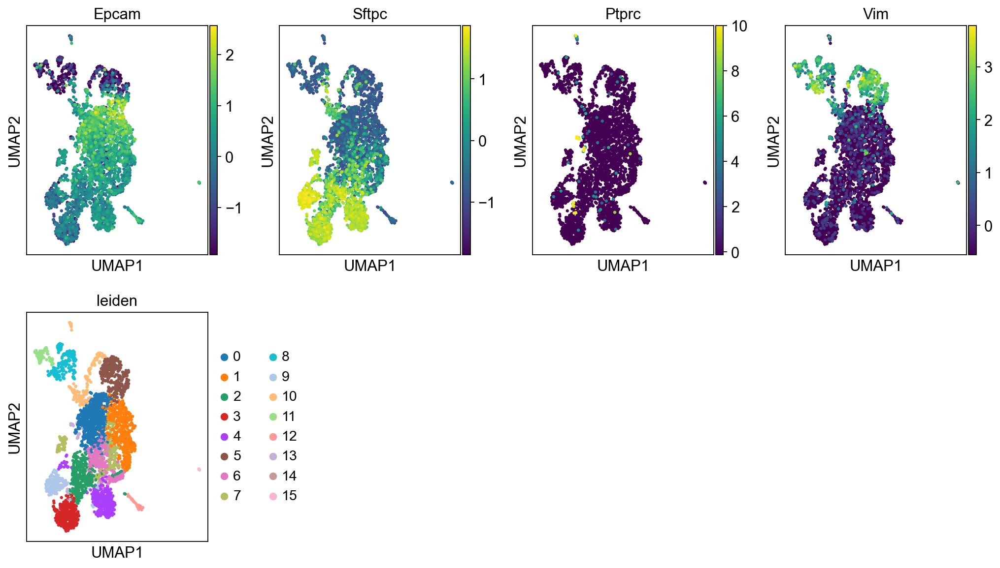

In [58]:
sc.pl.umap(adata, color=['Epcam', 'Sftpc', # Tumor cells
                         'Ptprc','Vim','leiden'])

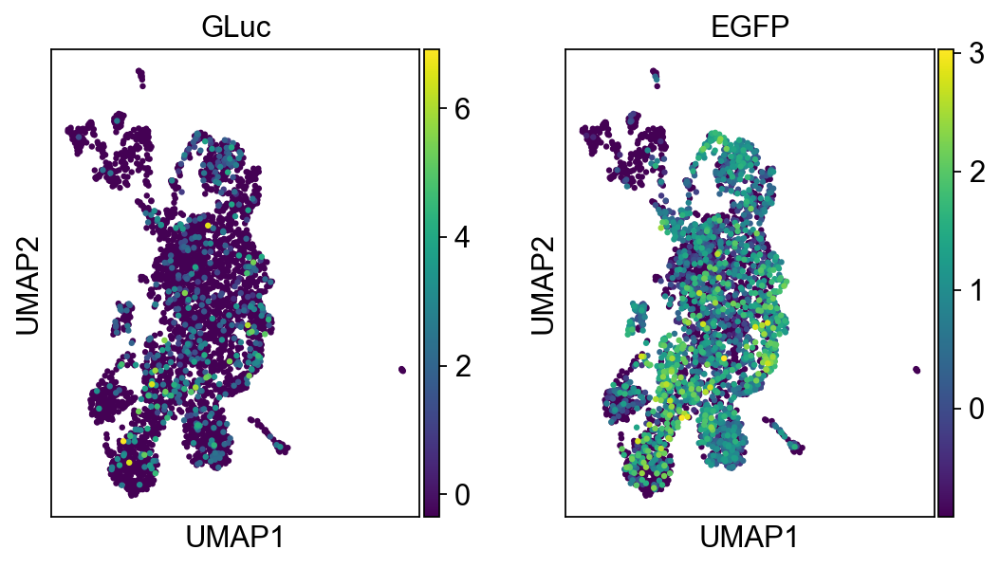

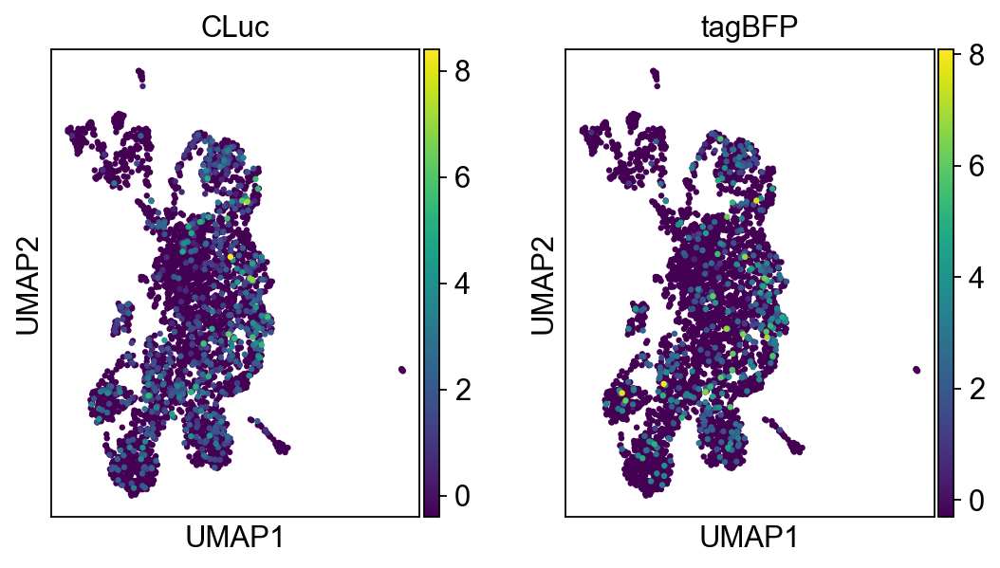

In [59]:
sc.pl.umap(adata, color=['GLuc','EGFP'])
sc.pl.umap(adata, color=['CLuc','tagBFP'])

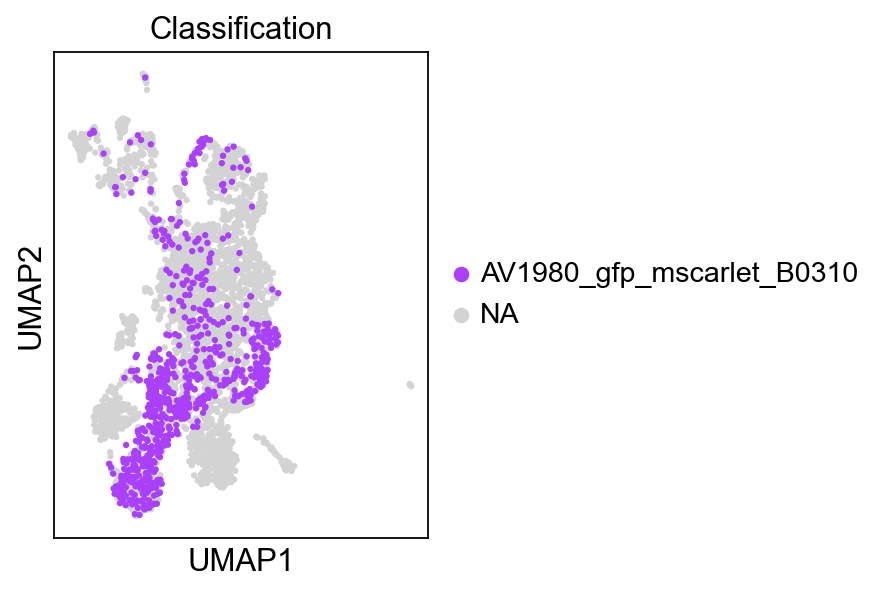

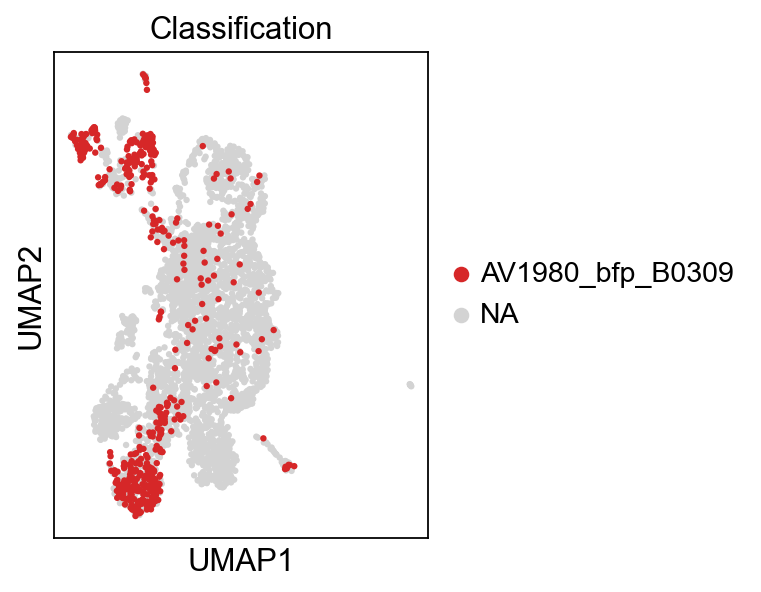

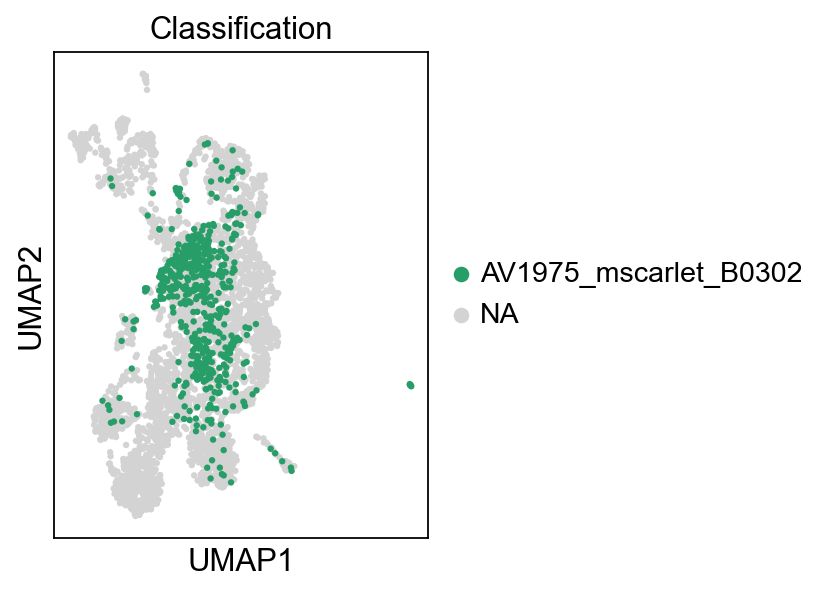

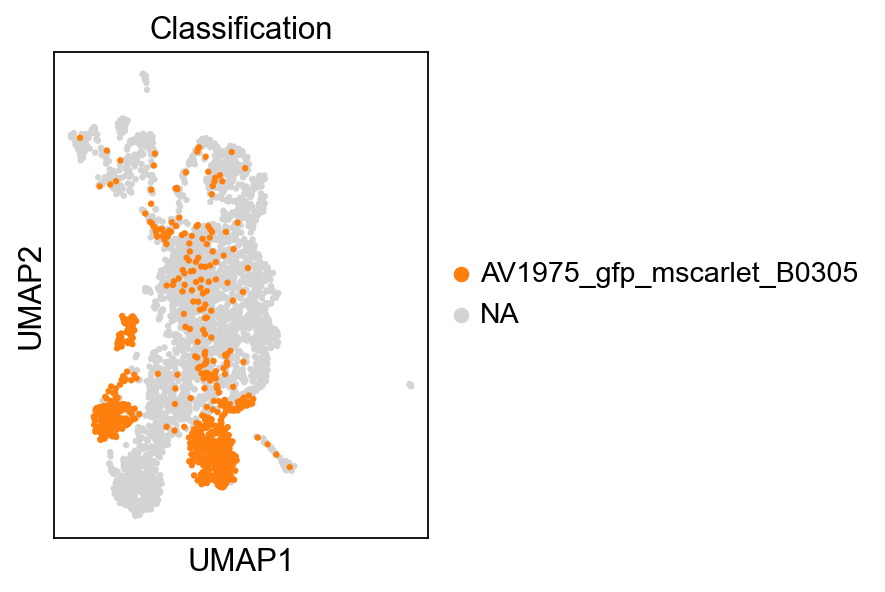

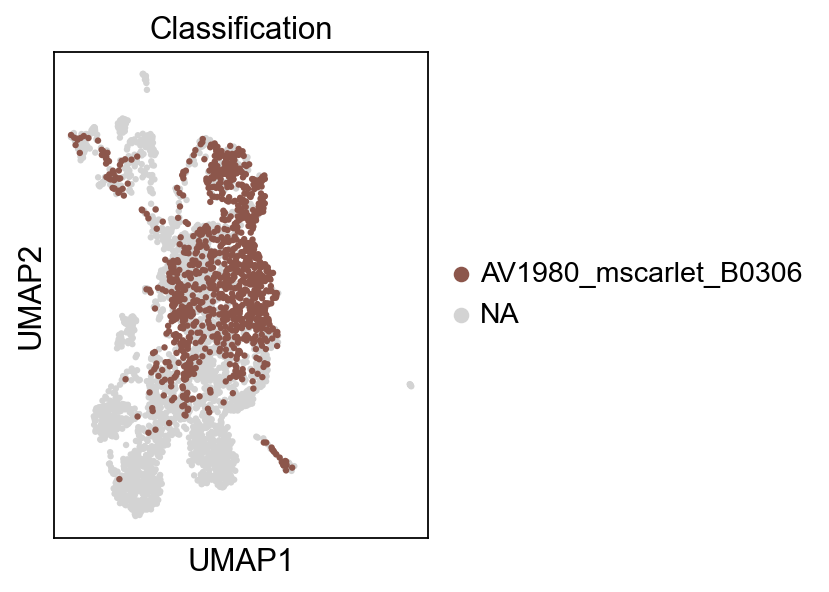

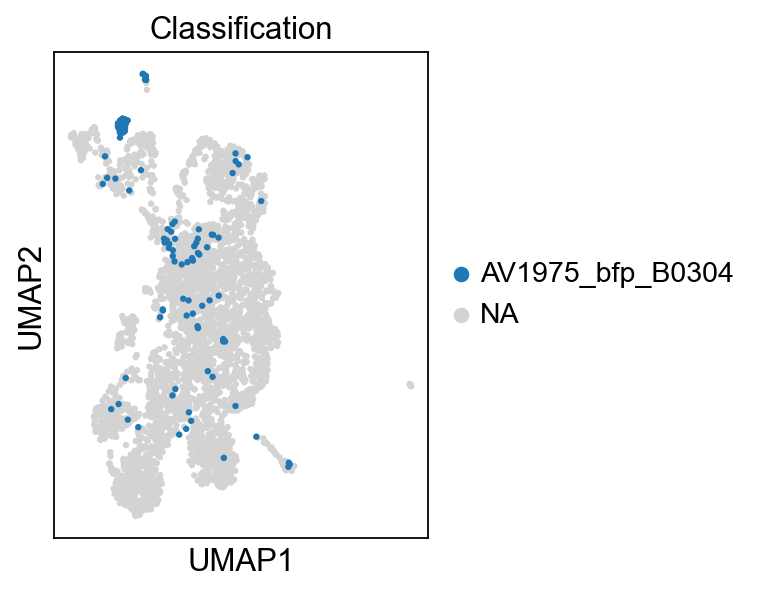

In [60]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

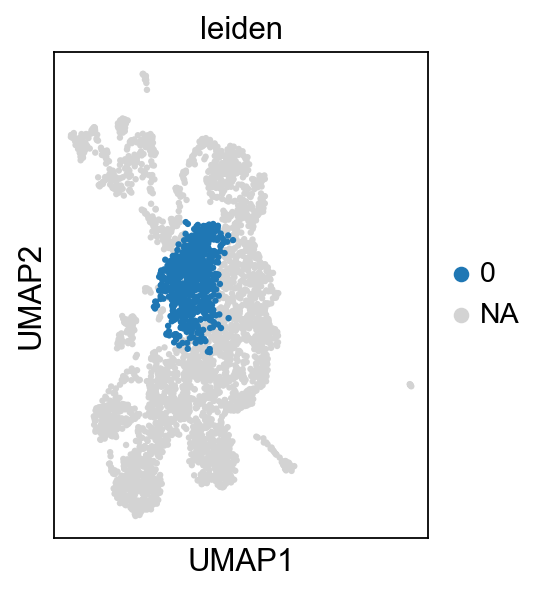

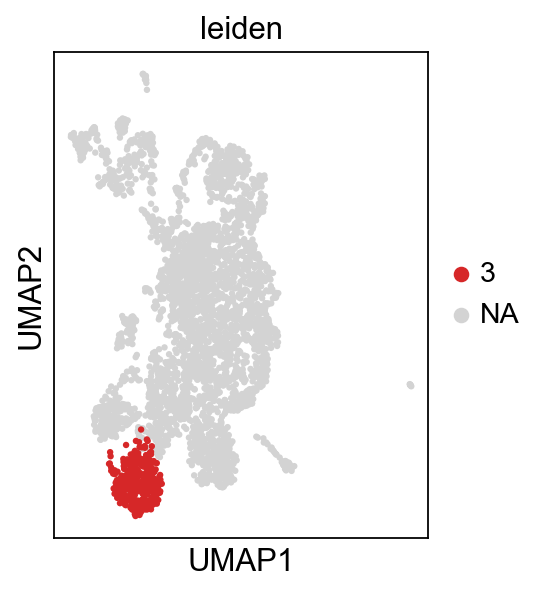

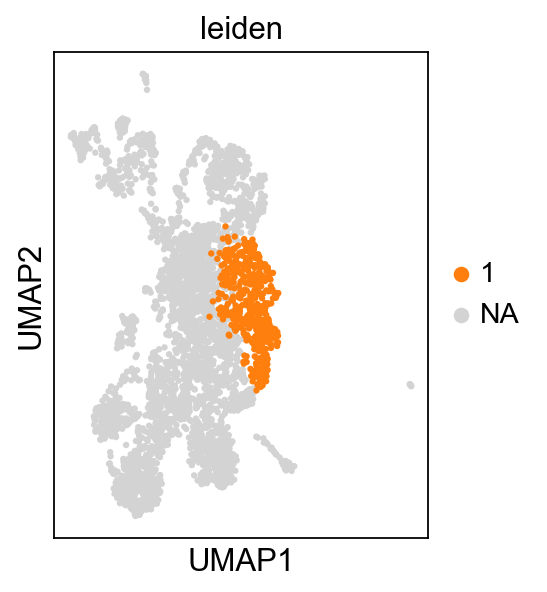

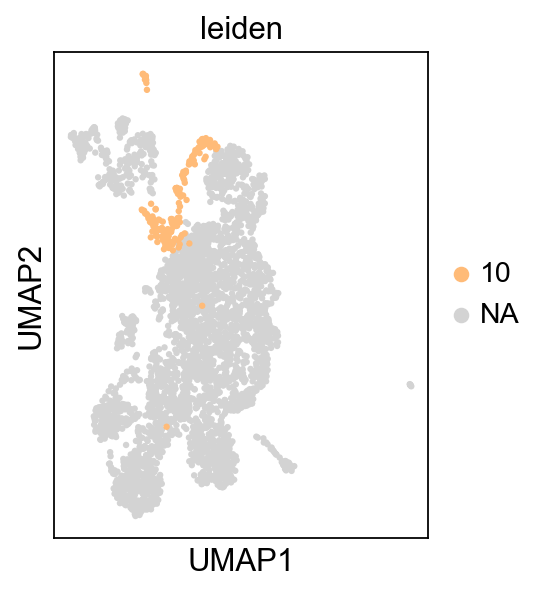

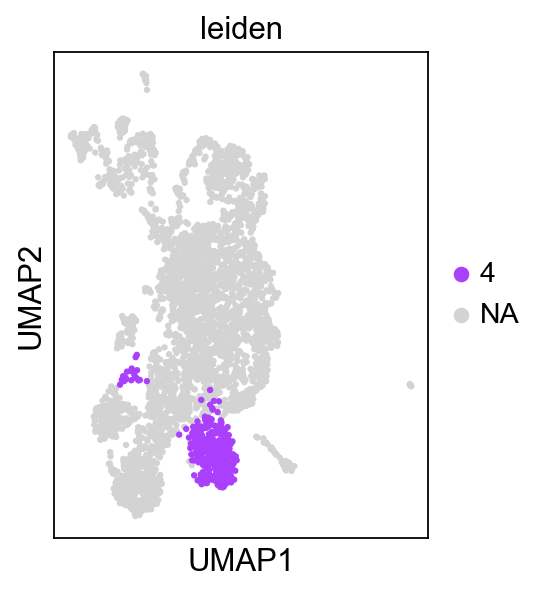

...

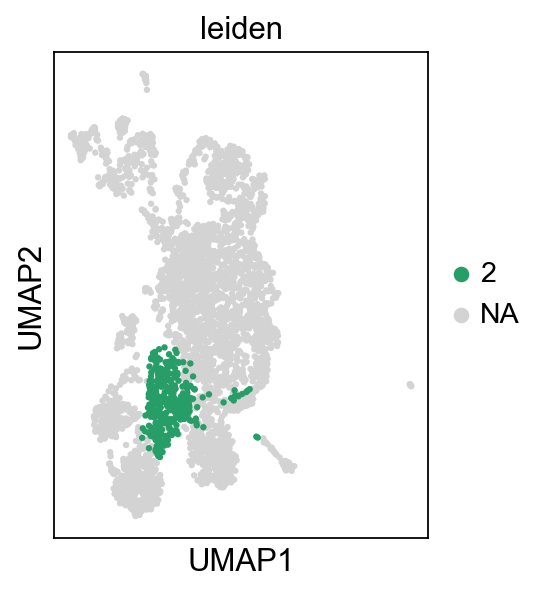

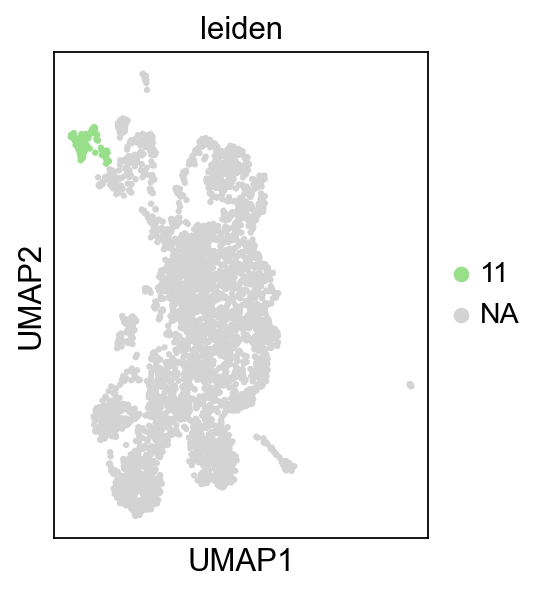

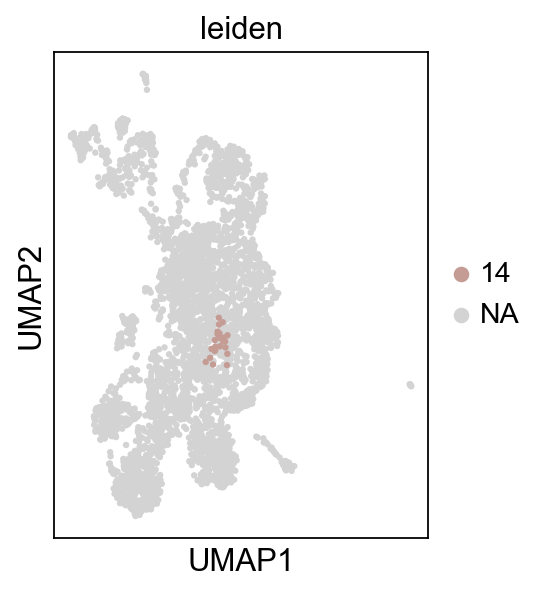

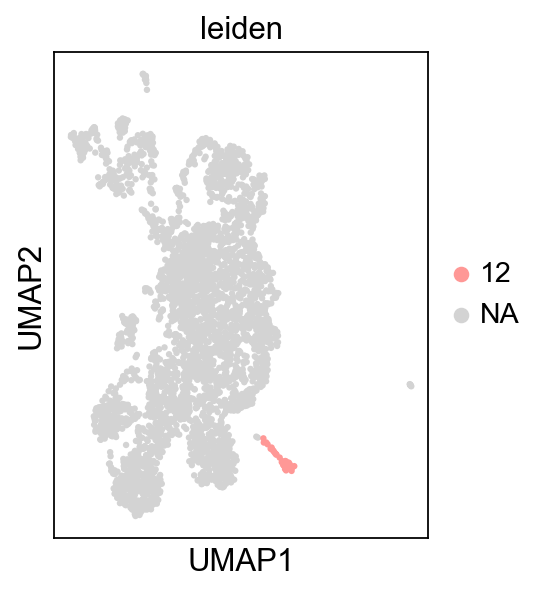

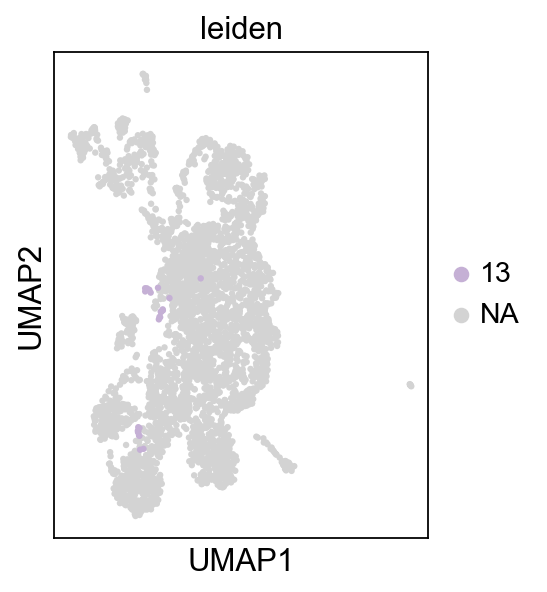

In [61]:
for label in adata.obs['leiden'].unique():
    sc.pl.umap(adata, color='leiden',groups=[label])

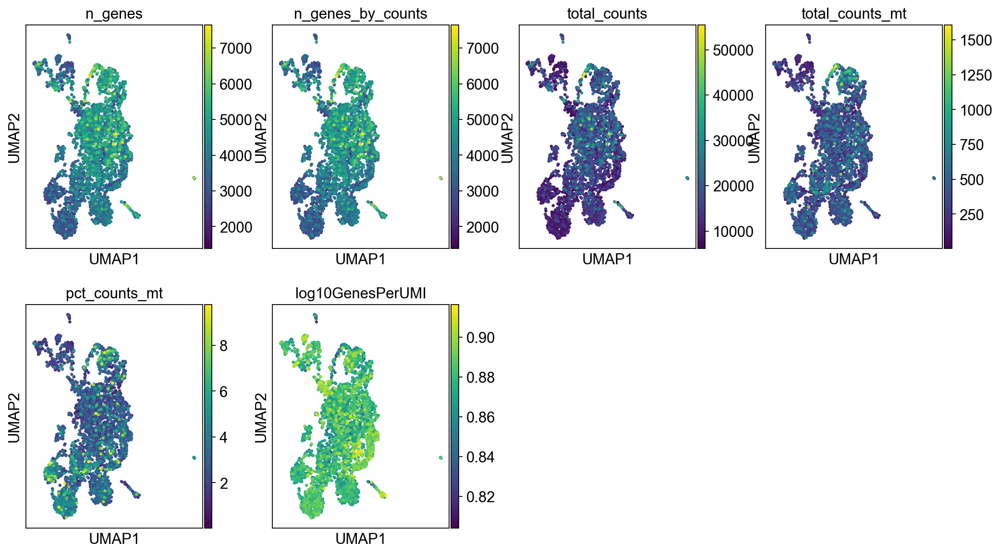

In [62]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

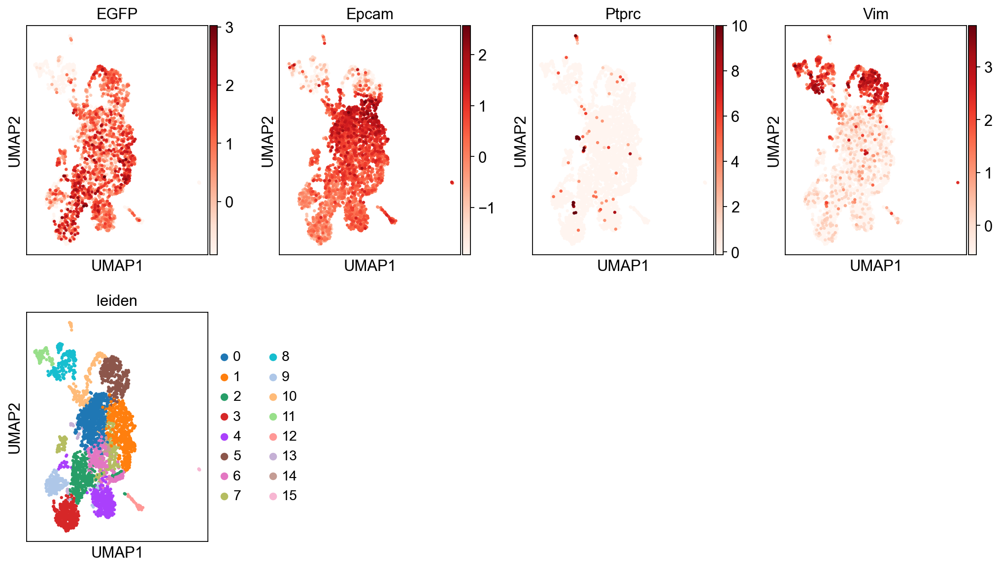

In [63]:
sc.pl.umap(adata, color=['EGFP','Epcam','Ptprc','Vim','leiden'],cmap="Reds")

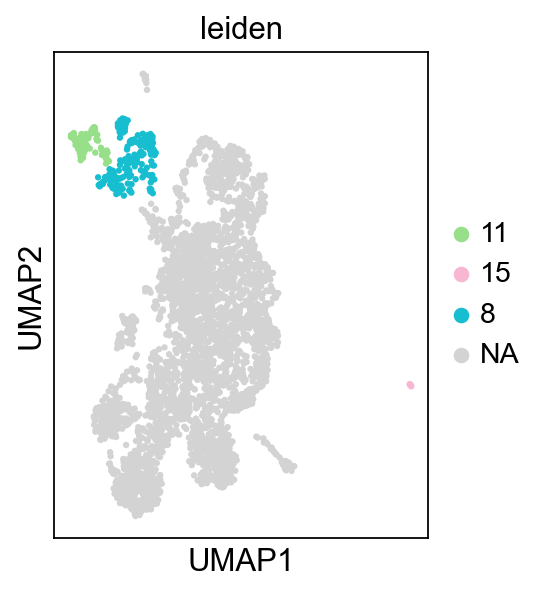

In [64]:
sc.pl.umap(adata,color=['leiden'],groups=['8','11','15']) #13 maybe

## Select tumor cells

In [65]:
# Select only subset of tumor cells
adata2 = sc.read('write/allmice-IGO14143.h5ad')
adata = adata2[~adata.obs['leiden'].isin(['8','11','15']),:] # keep tumor cells
del adata2

In [66]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/2000007.py:2: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['log1p'] = {}


In [67]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [68]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['mTagBFP2'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/1947291991.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/194729

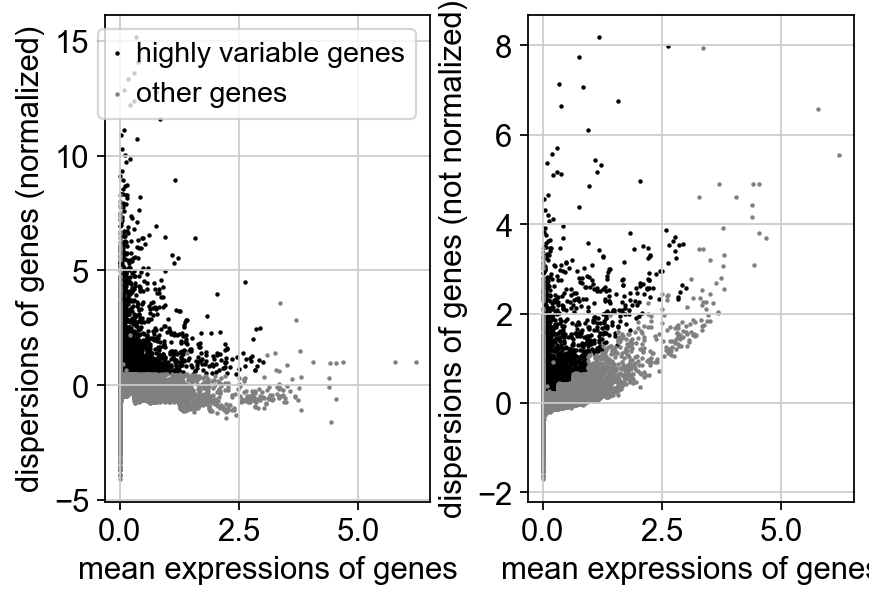

In [69]:
sc.pl.highly_variable_genes(adata)

## Now rerun algorithm

In [70]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [71]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


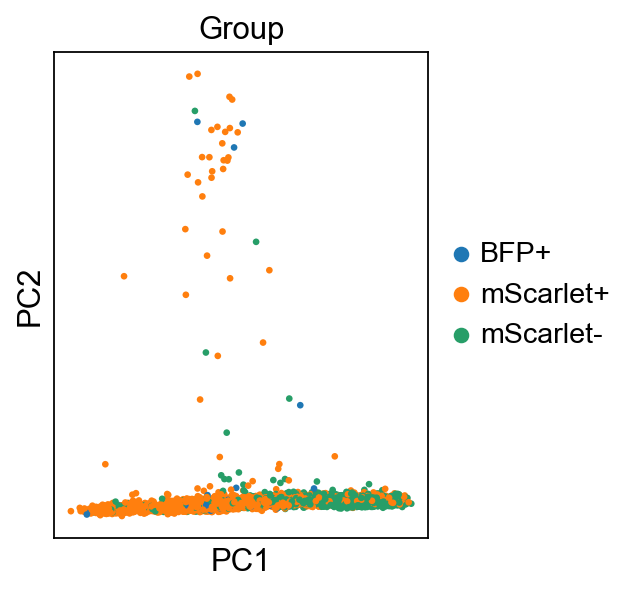

In [72]:
sc.pl.pca(adata, color='Group')

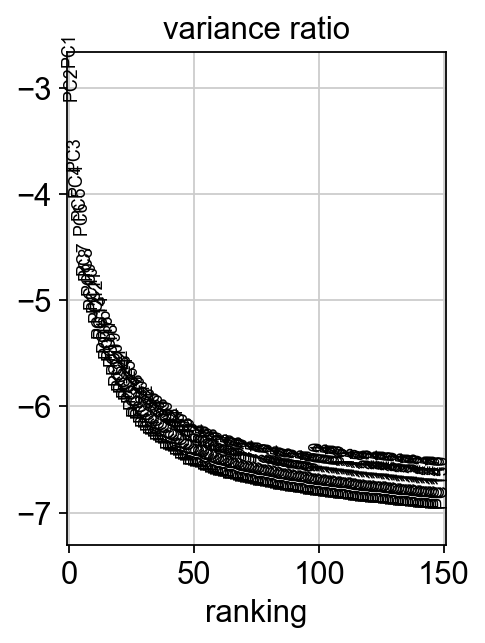

In [73]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

In [74]:
adata.write(results_file, compression='gzip')

In [75]:
adata

AnnData object with n_obs × n_vars = 3338 × 26134
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Group'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'Group_colors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

## Compute the neighborhood graph

In [76]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [77]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:08)


running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


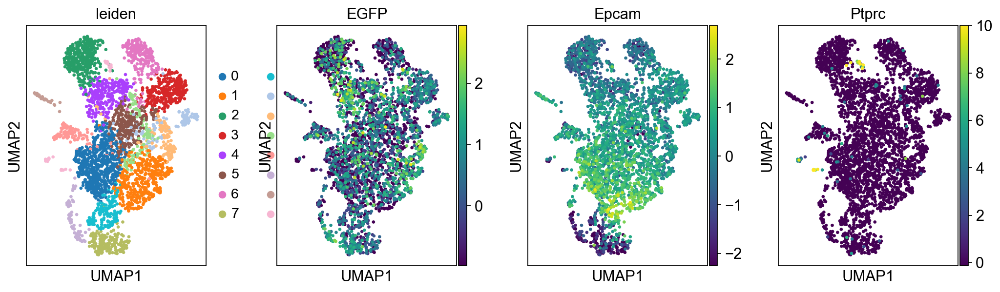

In [78]:
sc.tl.leiden(adata, resolution=.8)
sc.pl.umap(adata, color=['leiden','EGFP','Epcam','Ptprc'])

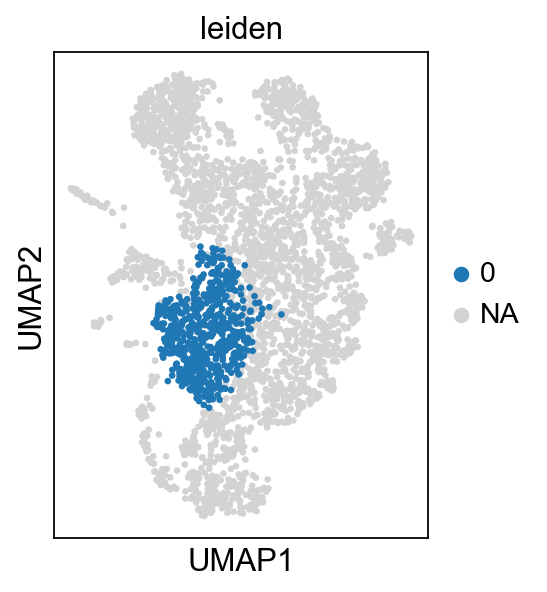

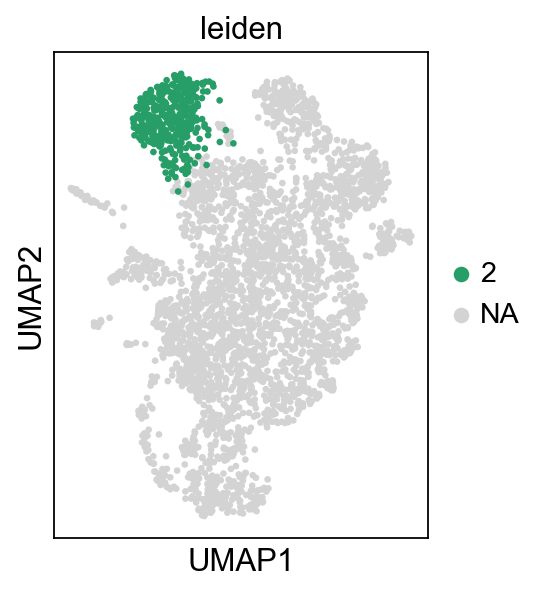

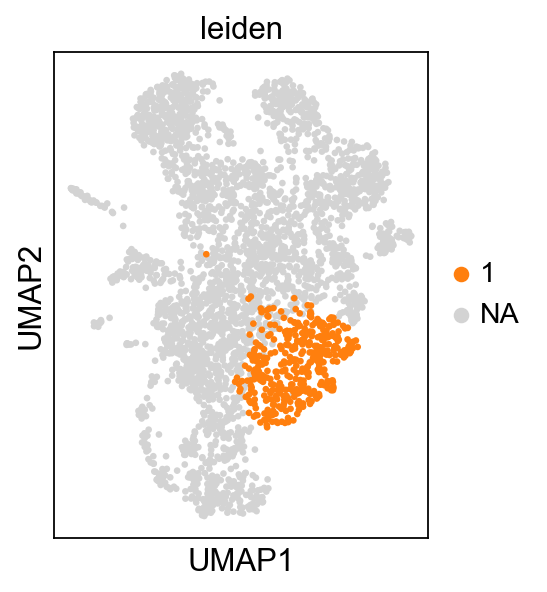

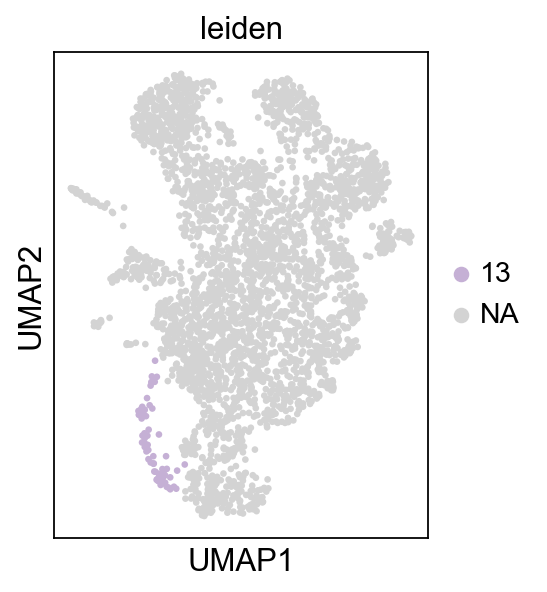

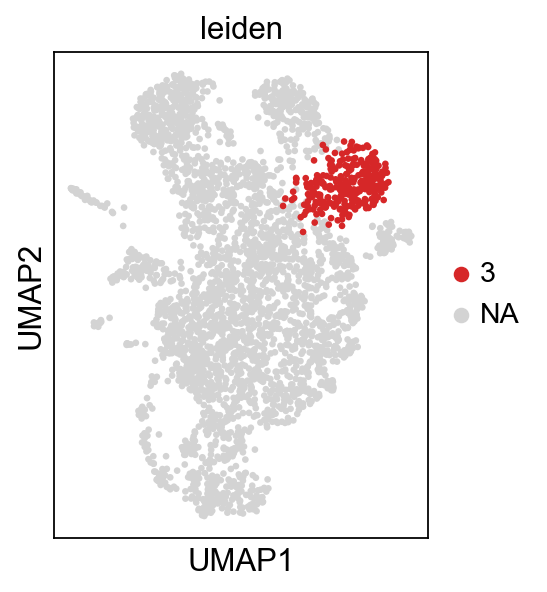

...

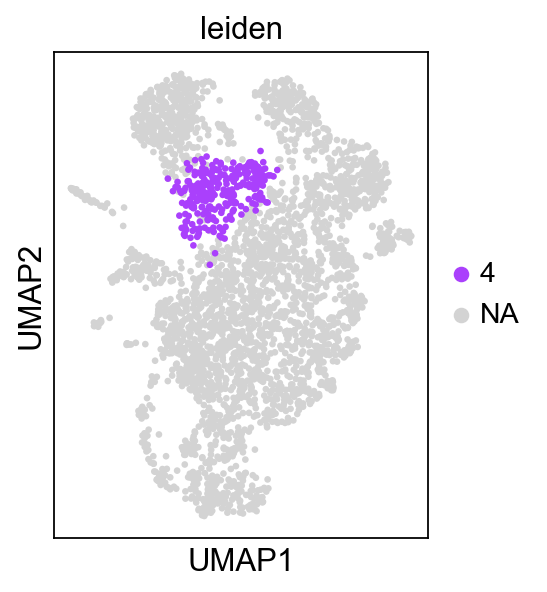

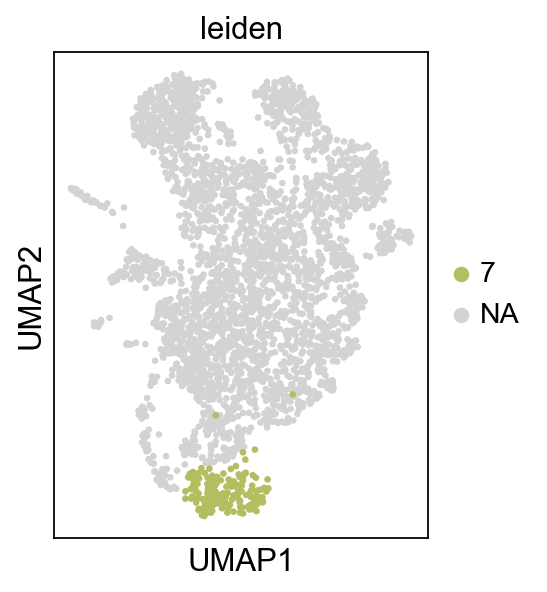

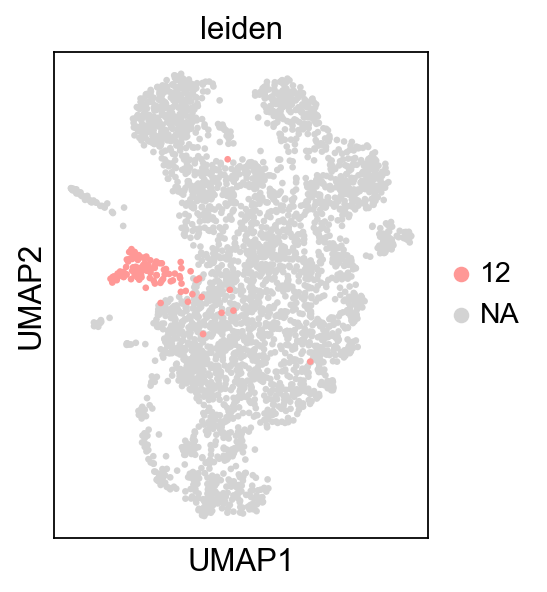

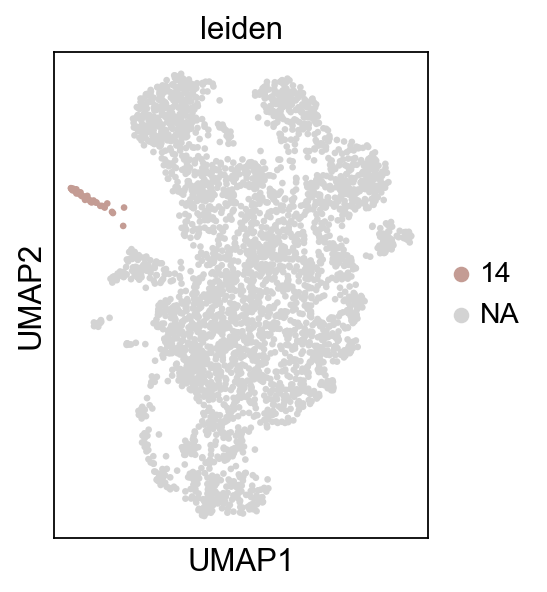

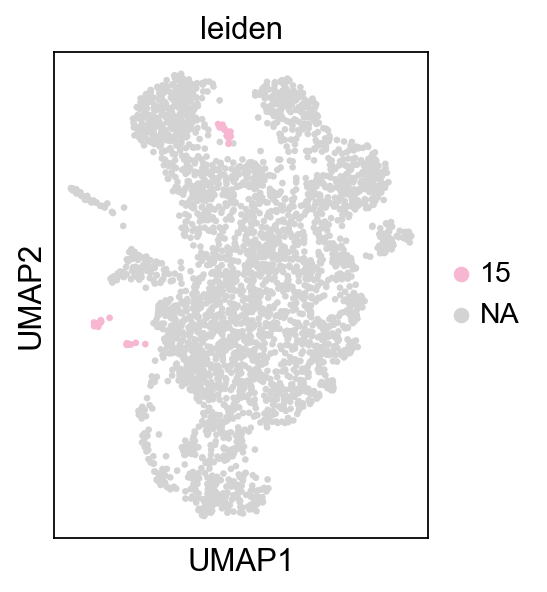

In [79]:
for label in adata.obs['leiden'].unique():
    sc.pl.umap(adata, color='leiden',groups=[label])

## Rerun filtering since this data is noisy

In [80]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/allmice-IGO14143.h5ad')
adata = adata2[adata[~adata.obs['leiden'].isin(['15'])].obs.index,:] # keep tumor cells
del adata2

In [81]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/2000007.py:2: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['log1p'] = {}


In [82]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [83]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['tagBFP'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/850513103.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/8505131

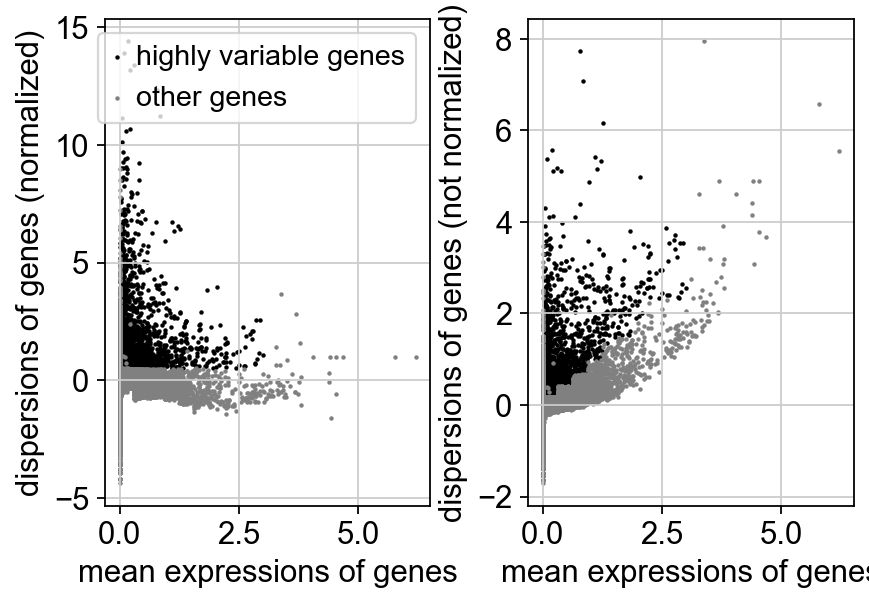

In [84]:
sc.pl.highly_variable_genes(adata)

In [85]:
adata.write('write/allmice-tumor-IGO14143.h5ad', compression='gzip')
adata = sc.read('write/allmice-tumor-IGO14143.h5ad')

## Now rerun algorithm

In [86]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [87]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:04)


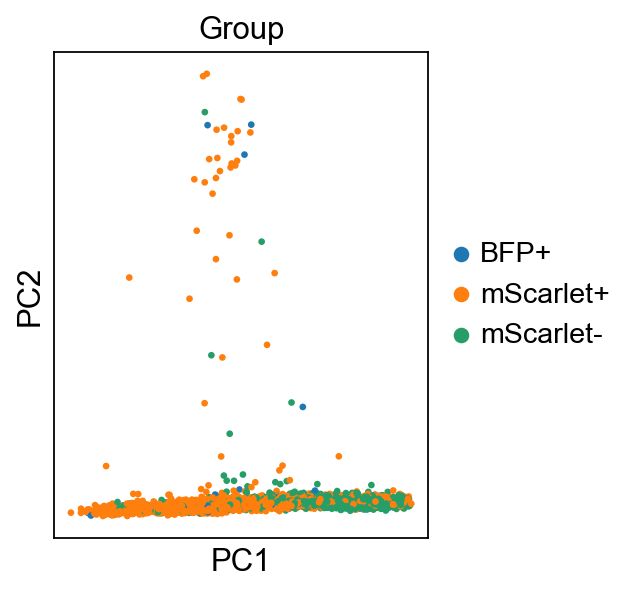

In [88]:
sc.pl.pca(adata, color='Group')

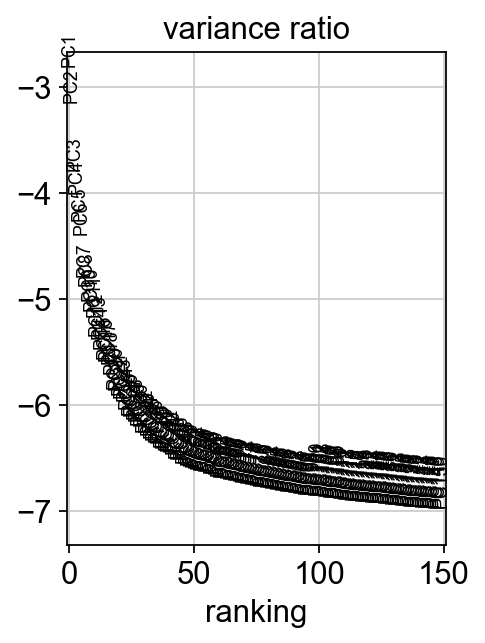

In [89]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

In [90]:
adata.write(results_file, compression='gzip')

In [91]:
adata

AnnData object with n_obs × n_vars = 3303 × 26134
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Group'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'Group_colors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

## Compute the neighborhood graph

In [92]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embed the neighborhood graph

In [93]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:08)


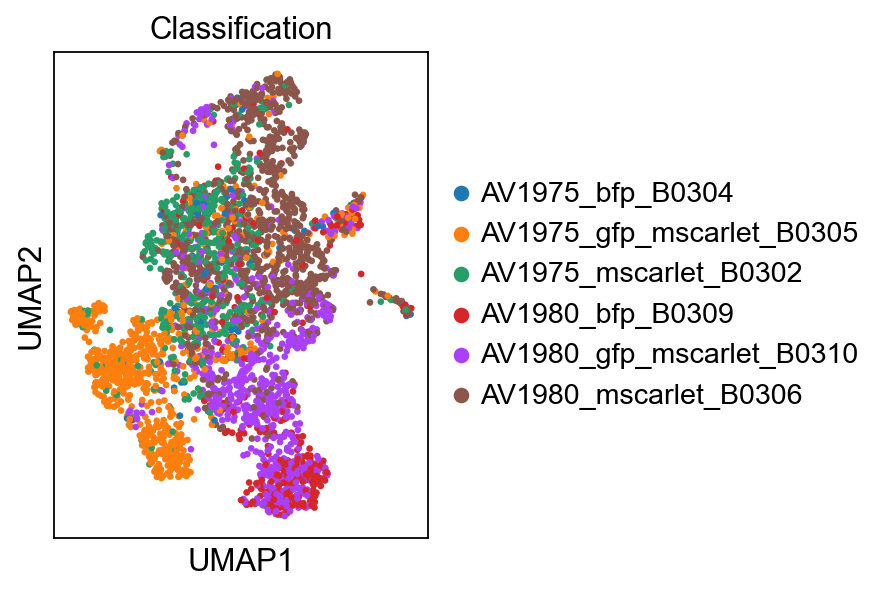

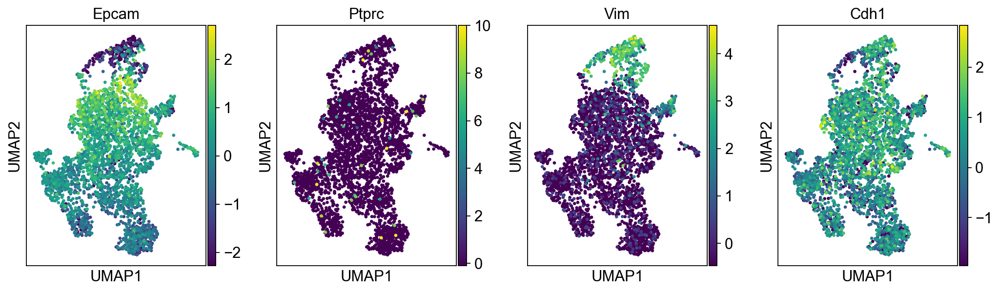

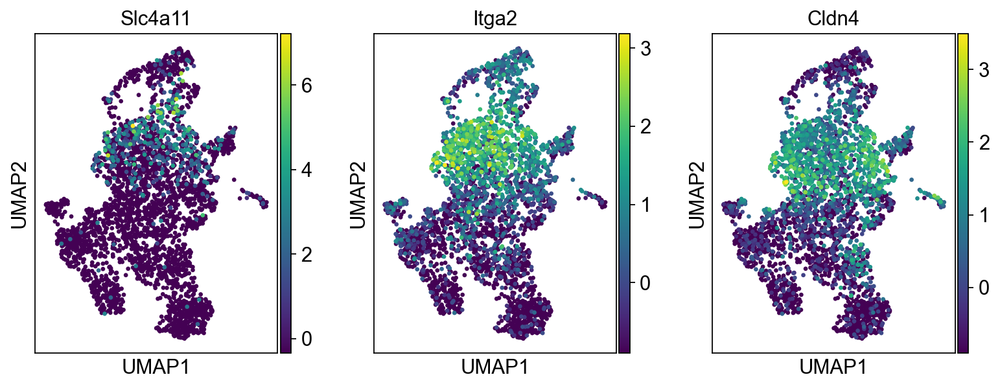

In [94]:
sc.pl.umap(adata, color=['Classification'])
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) # Look at marker genes
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) # # Look at HPCS genes

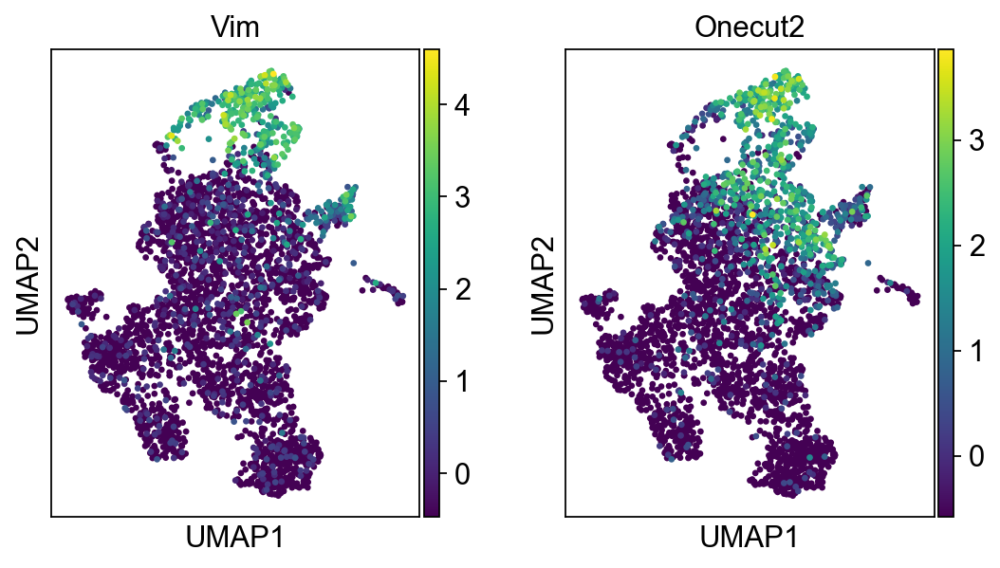

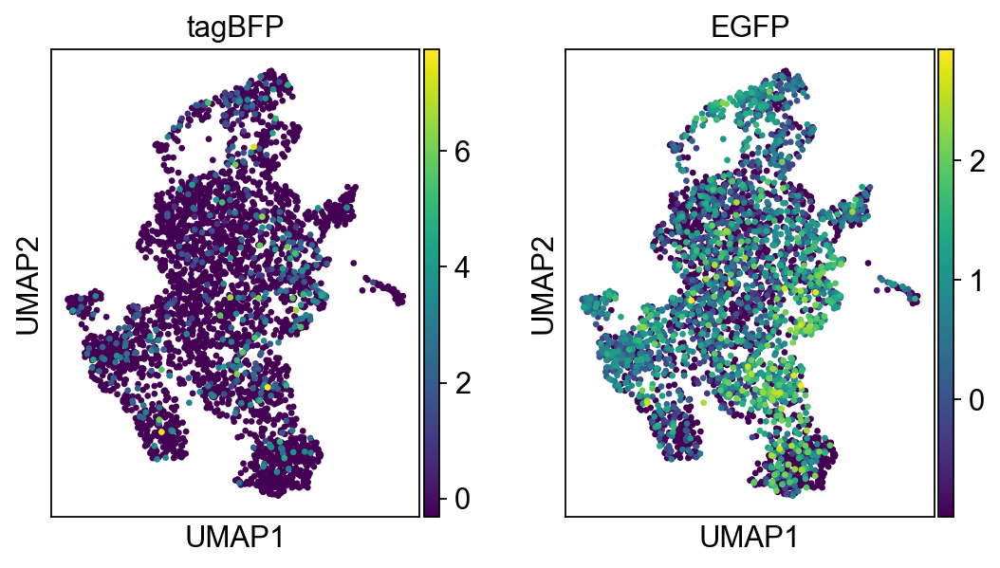

In [95]:
sc.pl.umap(adata, color=['Vim', 'Onecut2']) # EMT cluster genes
sc.pl.umap(adata, color=['tagBFP', 'EGFP']) # alleles

In [96]:
## Investigate marker genes

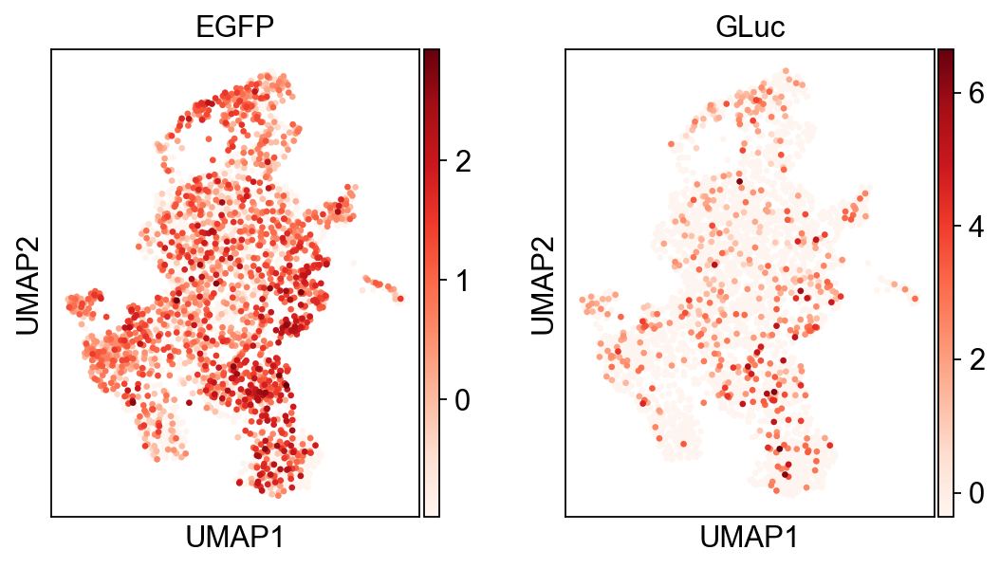

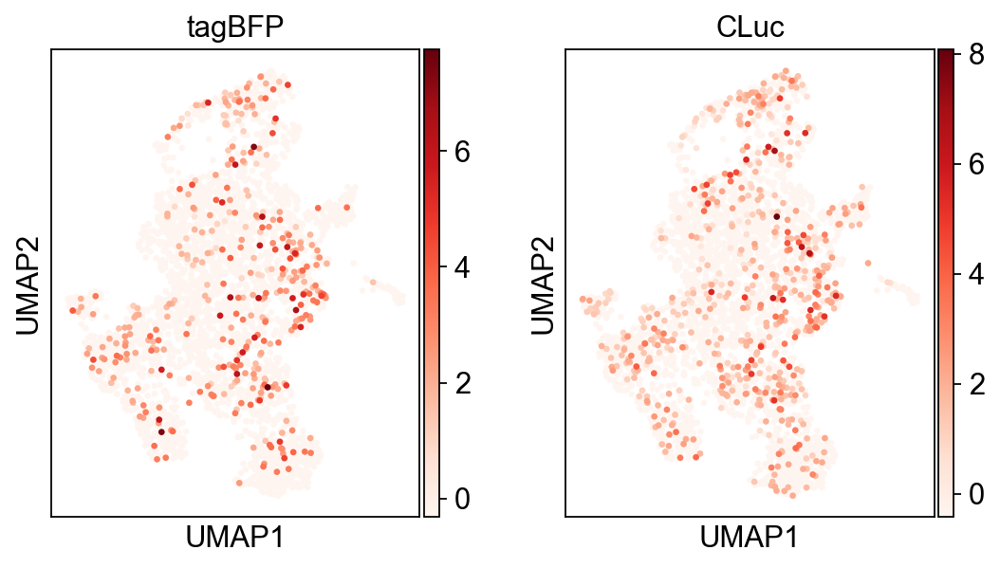

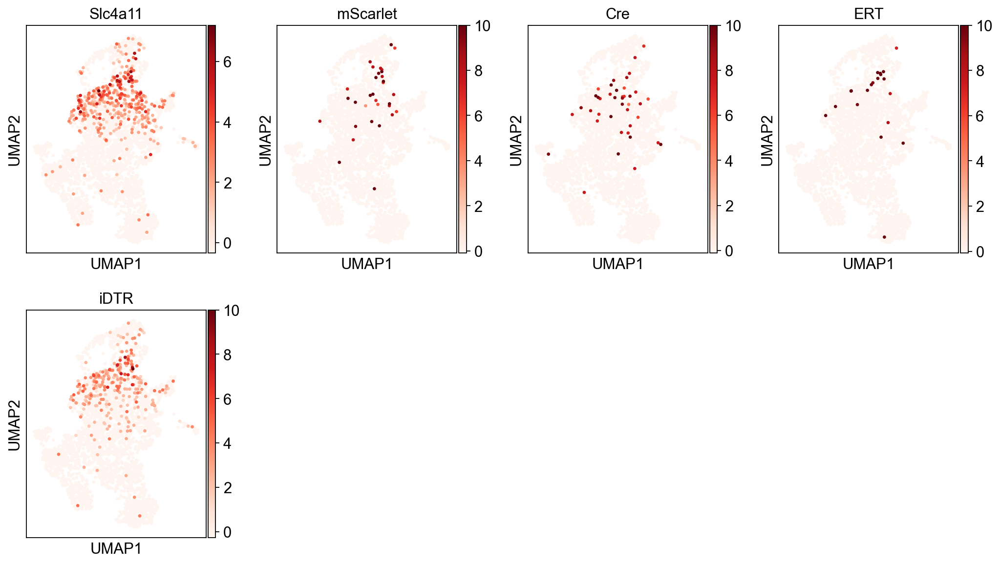

In [97]:
sc.pl.umap(adata, color=['EGFP','GLuc'], cmap='Reds')
sc.pl.umap(adata, color=['tagBFP','CLuc'], cmap='Reds')
sc.pl.umap(adata, color=['Slc4a11','mScarlet','Cre','ERT','iDTR'], cmap='Reds')

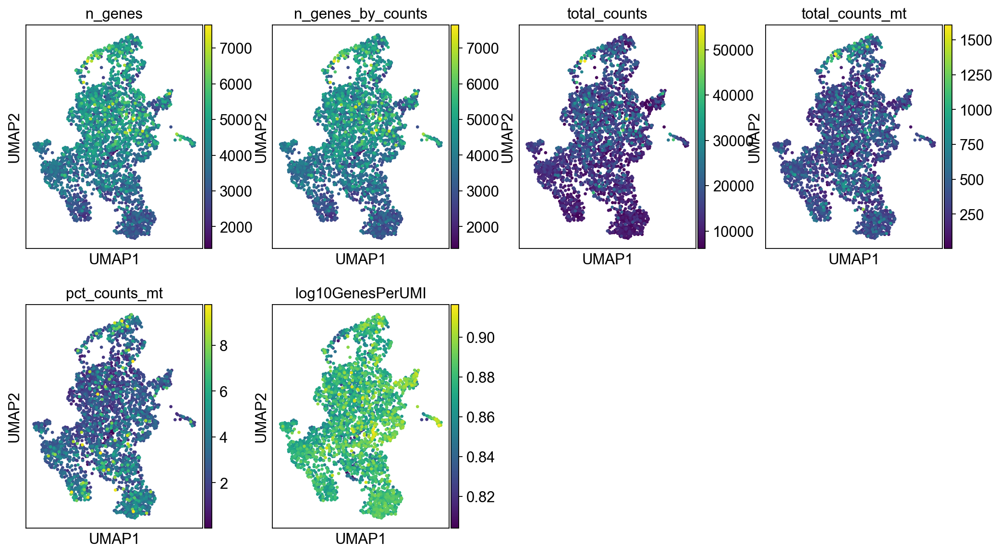

In [98]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

In [99]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


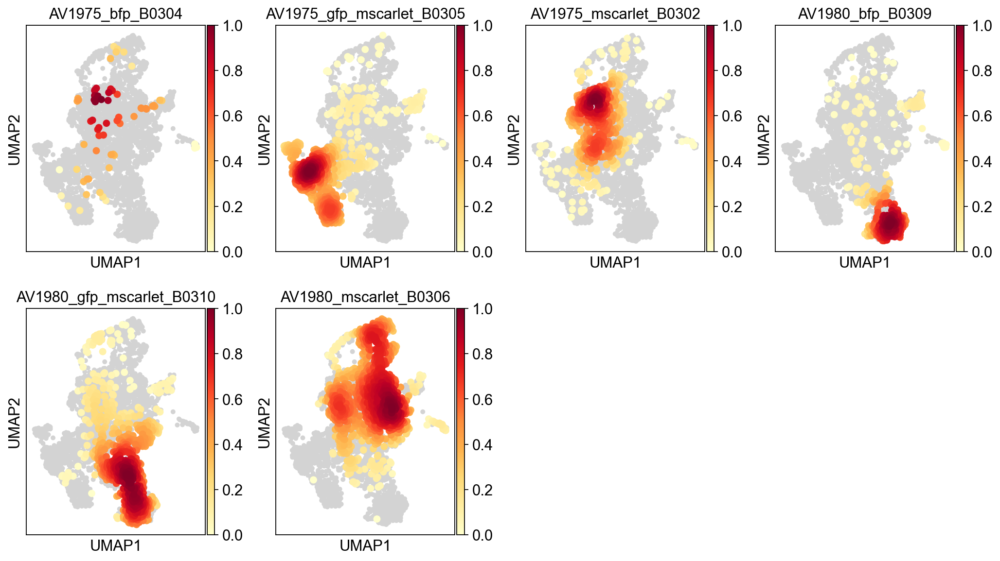

In [100]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

In [101]:
adata.obs.Classification.value_counts()

Classification
AV1980_mscarlet_B0306        1025
AV1980_gfp_mscarlet_B0310     723
AV1975_gfp_mscarlet_B0305     705
AV1975_mscarlet_B0302         494
AV1980_bfp_B0309              292
AV1975_bfp_B0304               64
Name: count, dtype: int64

## Cluster the neighborhood graph with leiden

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


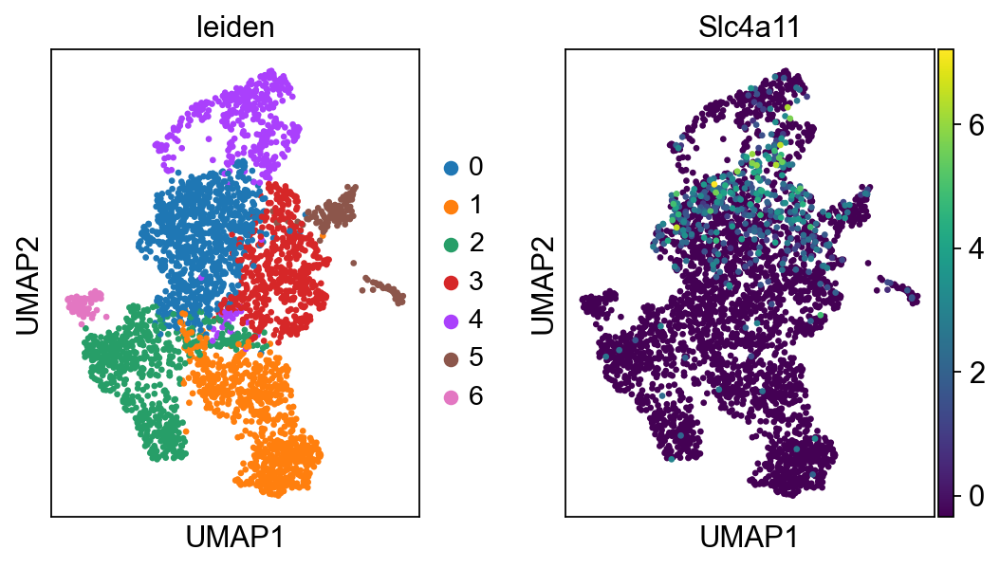

In [102]:
sc.tl.leiden(adata, resolution=.25)
sc.pl.umap(adata, color=['leiden','Slc4a11'])

## Score Cancer Cell clusters

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1992 total control genes are used. (0:00:01)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1295 total control genes are used. (0:00:01)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1687 total control genes are used. (0:00:01)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1694 total control genes are used. (0:00:01)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1584 total control genes are used. (0:00:01)
computing score 'Cluster 6'
       'Gm10179', 'Ldha-ps2'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    2188 total control genes are used. (0:00:01)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gen

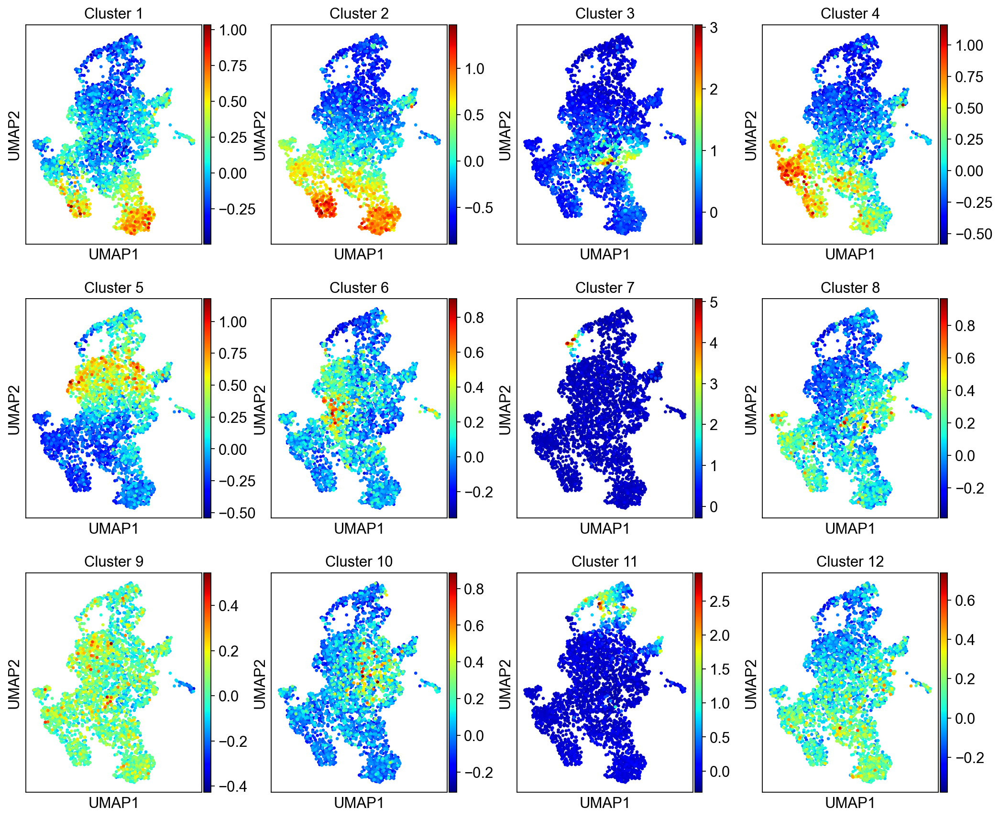

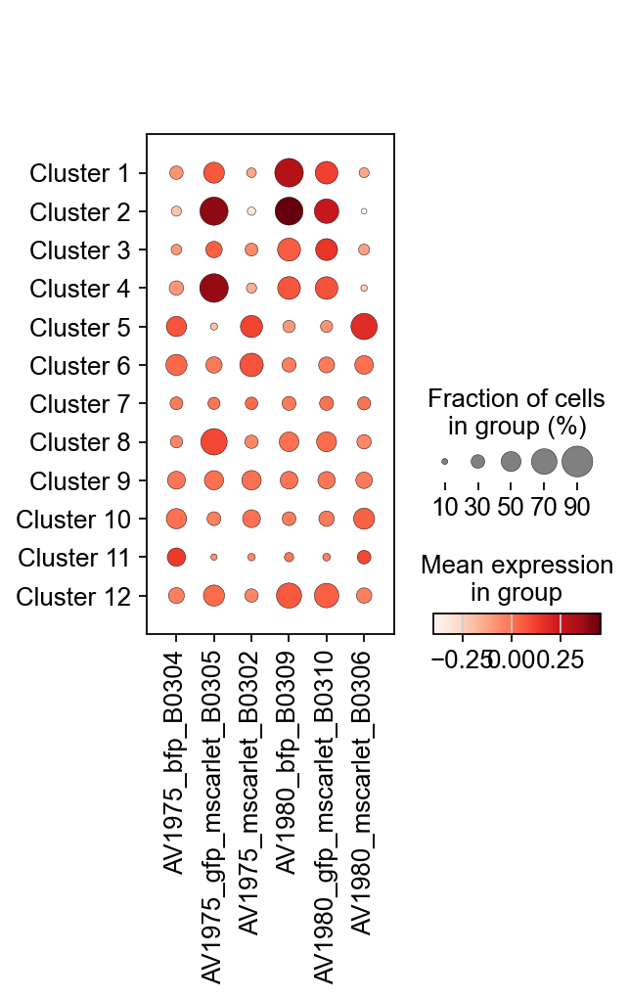

In [103]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata, numgenes=100)

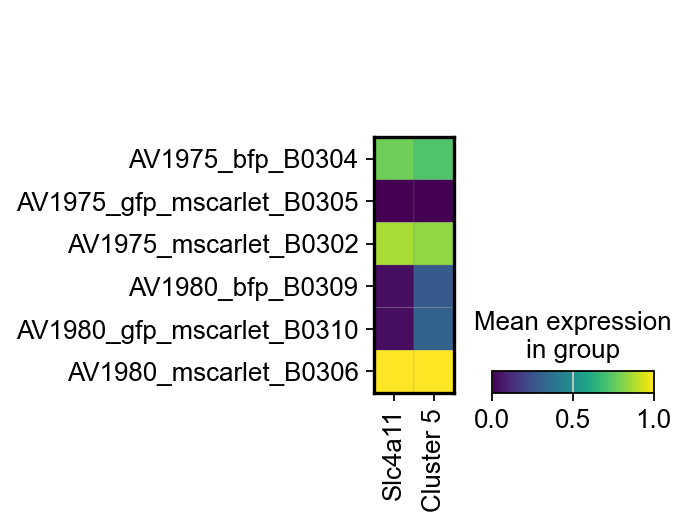

In [104]:
sc.pl.matrixplot(adata, ['Slc4a11','Cluster 5'], groupby='Classification', standard_scale='var')

Save the result.

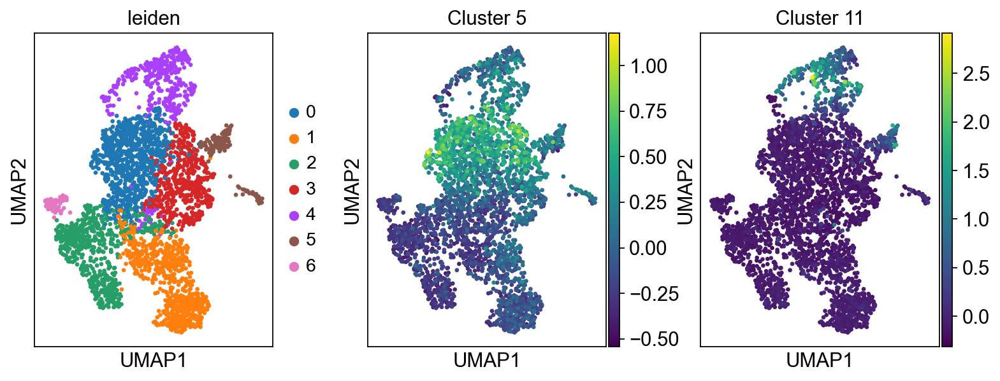

In [105]:
sc.pl.umap(adata, color=['leiden', 'Cluster 5', 'Cluster 11'])

In [106]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group      Classification           
BFP+       AV1975_bfp_B0304               64
mScarlet+  AV1975_mscarlet_B0302         494
           AV1980_bfp_B0309              292
           AV1980_mscarlet_B0306        1025
mScarlet-  AV1975_gfp_mscarlet_B0305     705
           AV1980_gfp_mscarlet_B0310     723
Name: count, dtype: int64

## Logistic Regression

In [107]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../common_files/genes.joblib')

In [108]:
adata_log = adata[:,adata.var.index.isin(names)]

In [109]:
adata_names = [x for x in adata_log.var.index]

In [110]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [111]:
smartseq = anndata.read('../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/anndata/__init__.py:42: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [112]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [113]:
names = [x for x in names_adata.var.index]

In [114]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1264: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [115]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[141,   6,   2,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  8,  69,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   1,   0,  67,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 179,   1,   0,   4,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   2,   0,   0,   3,   0,  55,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

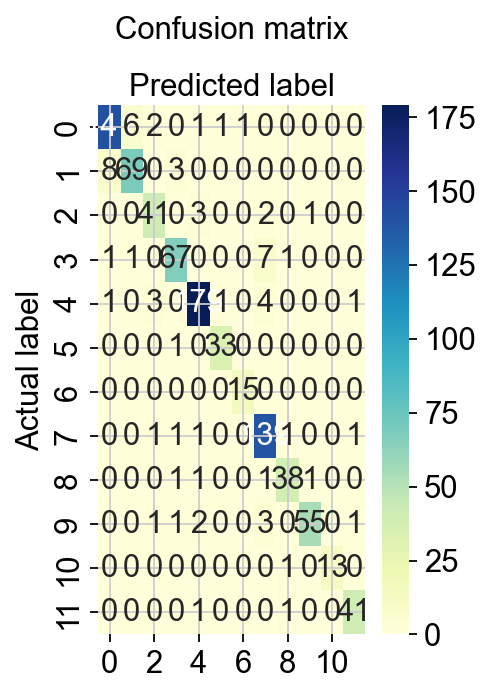

In [116]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [117]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.93      0.93      0.93       152
           2       0.91      0.86      0.88        80
           3       0.85      0.87      0.86        47
           4       0.91      0.87      0.89        77
           5       0.95      0.95      0.95       189
           6       0.94      0.97      0.96        34
           7       0.94      1.00      0.97        15
           8       0.89      0.97      0.93       144
           9       0.90      0.90      0.90        42
          10       0.96      0.87      0.92        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.92       900
   macro avg       0.93      0.92      0.92       900
weighted avg       0.92      0.92      0.92       900



In [118]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [119]:
y_test

KP_30w_ND_m3_T9_P2_S273            03
K_2w_ND_m4_T0_P1_S324              01
KP_30w_ND_m3_T7_P1_S313            08
KP_30w_ND_m2_T2_P5_S135            10
KP_20w_STb2_mLentiX1_T1_P2_S159    08
                                   ..
KP_20w_STb2_mAdCre1_T1_P3_S285     05
KP_18w_ND_m3_T1_P3_N1_S298         05
KP_30w_ND_m3_T9_P2_S204            08
KP_30w_ND_m3_T9_P1_S177            05
KP_20w_STb2_mAdCre2_T1_P2_S75      09
Name: clusterK12, Length: 900, dtype: category
Categories (12, object): ['01', '02', '03', '04', ..., '09', '10', '11', '12']

In [120]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/sklearn/utils/_plotting.py:175: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


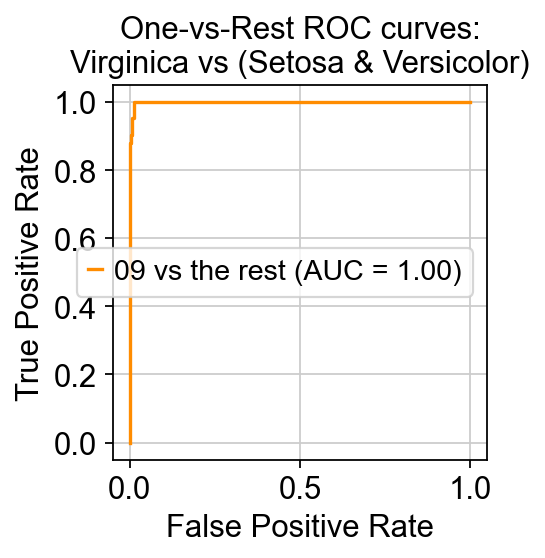

In [121]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [122]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [123]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [124]:
results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,1.757112e-08,1.051769e-04,1.255022e-01,2.077325e-02,1.522750e-06,4.679239e-05,4.125297e-04,8.525183e-01,2.791067e-06,2.445280e-05,2.264837e-05,5.903787e-04,0.852518,0
1,01,01,9.999898e-01,2.341114e-07,1.248060e-08,9.557788e-08,1.090003e-07,1.154491e-06,8.465005e-06,3.085733e-10,2.470804e-09,6.881592e-09,1.144669e-07,7.097479e-09,0.999990,1
2,08,08,4.329202e-09,2.647090e-07,3.960535e-07,2.175905e-06,7.540508e-06,9.191489e-07,3.724405e-05,9.998847e-01,8.096128e-06,5.210641e-05,6.041121e-06,4.850442e-07,0.999885,1
3,10,10,4.057905e-08,7.643520e-06,2.497790e-05,3.350814e-07,4.883346e-01,6.203417e-04,6.779251e-05,3.968264e-05,3.356536e-04,5.096231e-01,7.097528e-05,8.747979e-04,0.509623,1
4,08,08,6.492272e-08,4.303219e-07,5.865924e-08,3.979036e-06,1.000897e-05,1.151993e-06,1.053635e-04,9.995860e-01,2.643966e-04,1.693719e-05,6.053819e-06,5.552744e-06,0.999586,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.670219e-04,1.557365e-07,3.342431e-06,4.491757e-05,9.890016e-01,5.149915e-03,3.610461e-04,2.767729e-03,6.582462e-04,1.557610e-03,1.755598e-04,1.285029e-05,0.989002,1
896,05,05,3.156962e-10,3.740184e-07,2.538036e-07,1.868899e-07,9.999849e-01,7.153881e-06,3.802634e-07,7.186080e-10,1.286595e-07,2.574764e-07,5.367130e-06,9.615065e-07,0.999985,1
897,08,08,2.473310e-06,6.102663e-05,8.668294e-06,1.351087e-02,5.235462e-08,4.706025e-06,9.832487e-05,9.848976e-01,1.203688e-03,1.643918e-04,2.175158e-05,2.648124e-05,0.984898,1
898,05,05,8.610030e-11,2.350901e-07,5.889682e-06,1.324064e-11,9.999920e-01,7.660709e-08,3.645985e-07,7.020455e-07,7.906928e-08,7.965992e-08,4.609287e-07,1.194799e-07,0.999992,1


In [125]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.35-0.88,0.350544,0.876810,0.643411
1,0.88-0.98,0.876810,0.980419,0.890625
2,0.98-1.0,0.980419,0.996683,0.945736
3,1.0-1.0,0.999055,0.999882,0.996109


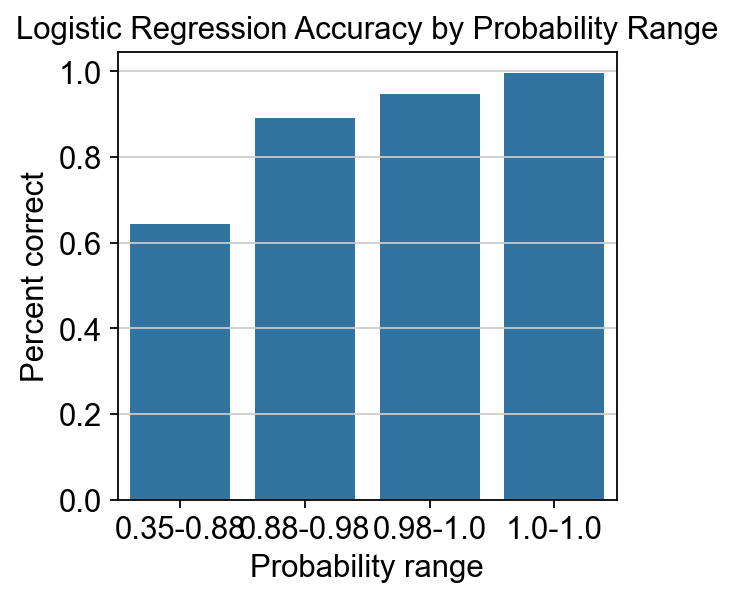

In [126]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [127]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

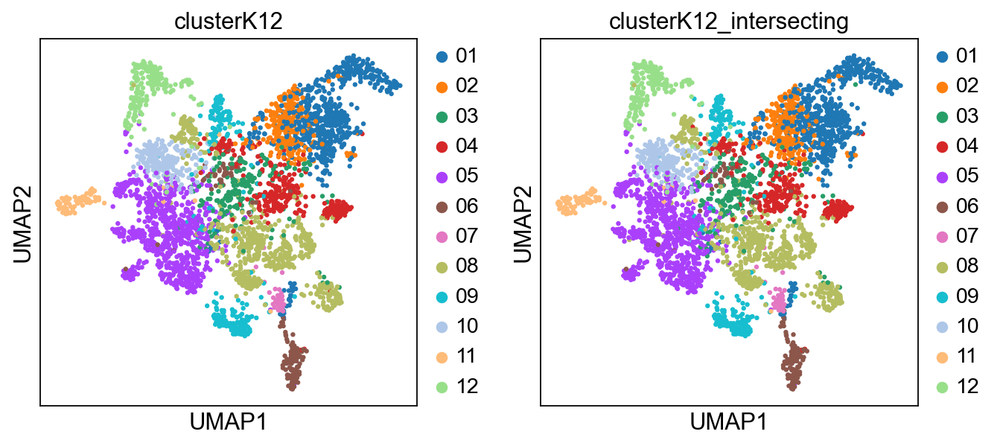

In [128]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [129]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [130]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9808333333333333

In [131]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.223479e-12,1.655468e-10,1.065016e-10,2.896449e-13,1.425552e-08,2.926334e-11,4.551368e-09,7.429318e-12,1.799909e-10,8.409494e-11,1.000000e+00,1.508826e-09,1.000000
1,12,2.028187e-10,2.545622e-11,8.643889e-11,2.629267e-09,2.567577e-09,9.341040e-07,1.630178e-08,3.294883e-08,8.240436e-08,4.372233e-07,8.573603e-09,9.999985e-01,0.999998
2,05,8.804032e-04,1.866487e-07,3.561095e-04,1.993322e-07,9.987425e-01,1.504538e-05,6.872856e-07,8.409089e-11,2.187686e-07,8.851532e-07,8.214115e-07,2.904811e-06,0.998743
3,10,5.455591e-07,4.039868e-07,5.101663e-07,1.778975e-03,7.122312e-07,8.644244e-06,7.148697e-06,2.175112e-03,8.658239e-06,9.959974e-01,4.200955e-06,1.766171e-05,0.995997
4,01,9.999966e-01,5.215363e-09,1.365448e-06,1.493073e-06,1.011399e-08,9.138766e-08,6.872826e-08,2.120731e-10,1.520278e-10,7.224294e-09,2.993214e-07,1.545627e-08,0.999997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,3.698284e-10,1.043734e-07,8.536598e-09,1.456313e-07,1.552366e-08,8.545777e-09,6.606526e-07,9.999949e-01,3.868823e-06,1.719274e-07,6.723614e-08,1.134631e-08,0.999995
3596,09,8.707320e-08,2.415545e-07,1.225312e-07,8.959917e-08,1.165545e-06,4.275537e-08,1.290131e-06,3.351799e-04,9.996583e-01,2.528106e-07,3.151354e-06,1.065295e-07,0.999658
3597,08,4.014415e-08,4.162906e-06,8.846180e-08,4.221811e-05,2.593283e-08,5.956922e-08,7.374659e-06,9.998338e-01,1.059879e-04,2.969645e-06,2.316414e-06,9.630813e-07,0.999834
3598,08,6.065905e-09,1.702471e-06,2.331003e-06,1.557799e-06,3.173239e-04,1.605719e-07,8.325007e-06,9.996450e-01,6.017244e-06,1.262567e-05,3.327785e-06,1.625507e-06,0.999645


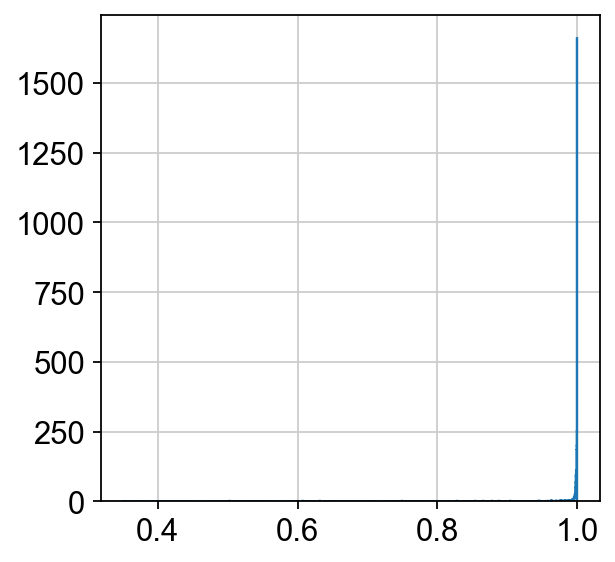

In [132]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## Now Apply Logistic Regression Model to this data

In [133]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [134]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [135]:
y_pred = logreg.predict(adata_log_ordered.X)

In [136]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [137]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

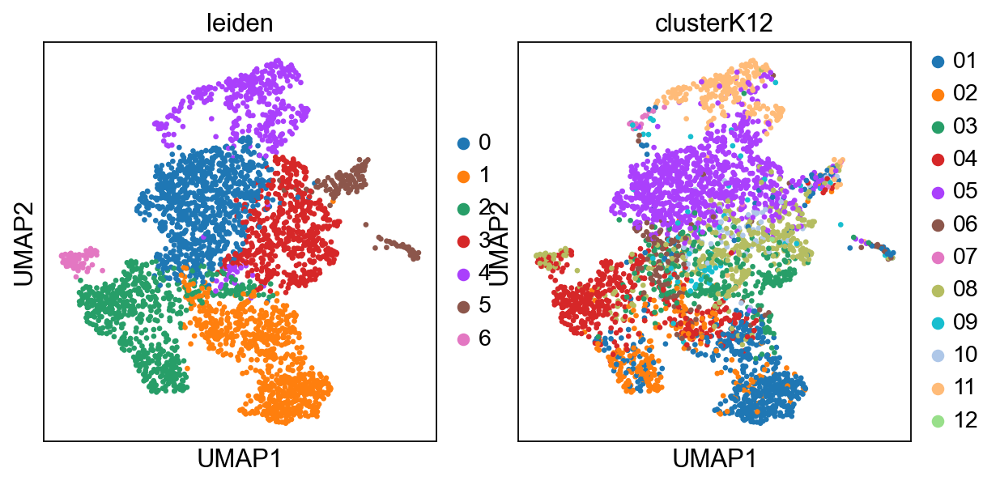

In [138]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

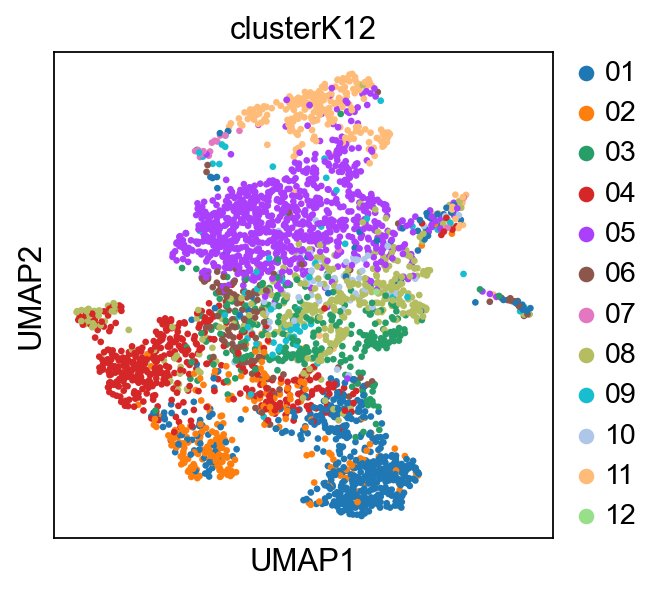

In [139]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

In [140]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

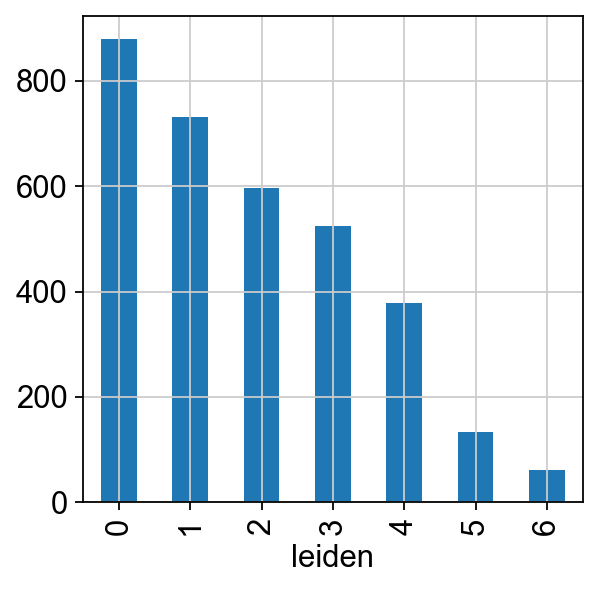

In [141]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

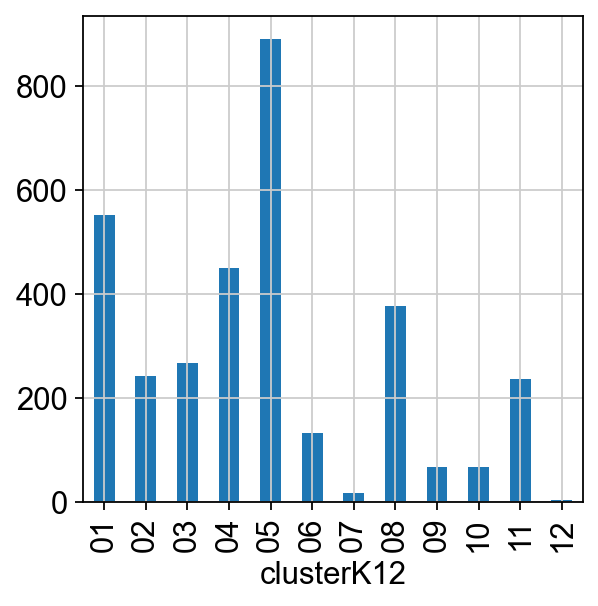

In [142]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

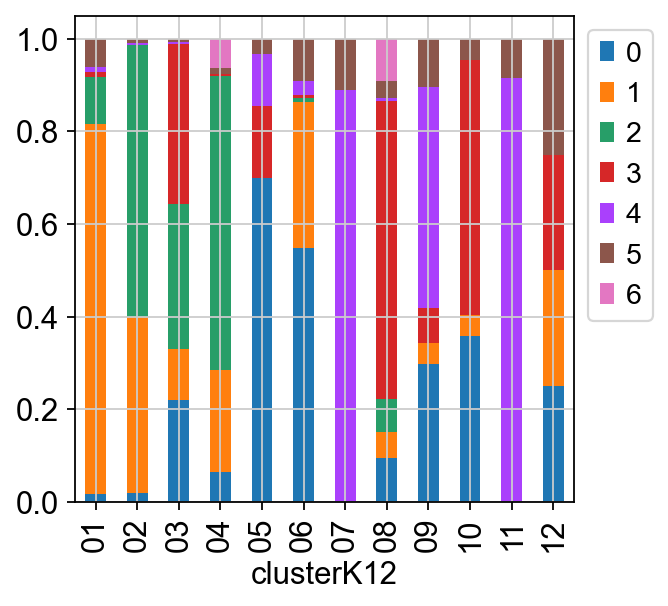

In [143]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [144]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,09,2.693439e-02,2.937861e-04,2.758502e-01,5.419422e-03,1.709705e-01,1.424670e-01,2.537793e-03,1.203342e-03,3.595119e-01,6.658578e-03,2.788431e-03,5.364529e-03,0.359512
1,01,9.986631e-01,1.250631e-03,1.258607e-06,3.453732e-05,7.595174e-08,4.460378e-06,7.502781e-06,1.407599e-06,2.134164e-05,5.323796e-07,9.409793e-06,5.771899e-06,0.998663
2,05,6.522479e-05,2.835456e-04,7.081203e-04,9.487349e-05,6.815273e-01,9.171753e-02,2.538775e-03,6.325194e-02,6.323342e-03,1.494341e-01,7.664632e-04,3.288820e-03,0.681527
3,11,2.709155e-03,1.403239e-03,2.362331e-03,1.247659e-05,1.919391e-01,9.260722e-03,9.773108e-03,1.312339e-02,1.970331e-02,2.611795e-03,7.413683e-01,5.733111e-03,0.741368
4,04,9.972165e-05,8.178392e-02,2.302341e-04,8.750432e-01,1.383215e-07,1.824579e-04,4.022206e-04,4.140992e-02,3.010718e-04,1.020781e-04,8.774003e-05,3.573059e-04,0.875043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3298,08,1.306550e-06,5.426262e-05,3.071798e-06,4.935934e-02,2.460535e-08,6.391108e-06,6.379047e-05,9.489951e-01,1.366675e-03,1.287072e-04,1.020565e-05,1.111770e-05,0.948995
3299,05,1.021988e-07,1.521643e-11,9.889984e-10,5.323312e-11,9.999946e-01,1.848166e-07,2.933956e-07,3.744994e-08,3.826636e-07,3.889506e-06,4.883836e-07,7.005204e-08,0.999995
3300,08,1.272233e-05,1.016134e-04,3.458038e-01,1.832591e-03,1.385640e-03,5.637971e-04,9.250664e-04,5.574607e-01,9.470754e-05,9.002320e-02,2.530627e-04,1.543030e-03,0.557461
3301,04,3.018895e-01,5.576570e-03,1.263346e-03,3.346009e-01,1.393384e-05,2.479166e-01,4.543183e-03,3.798611e-03,9.691802e-02,5.137152e-04,1.340289e-03,1.625287e-03,0.334601


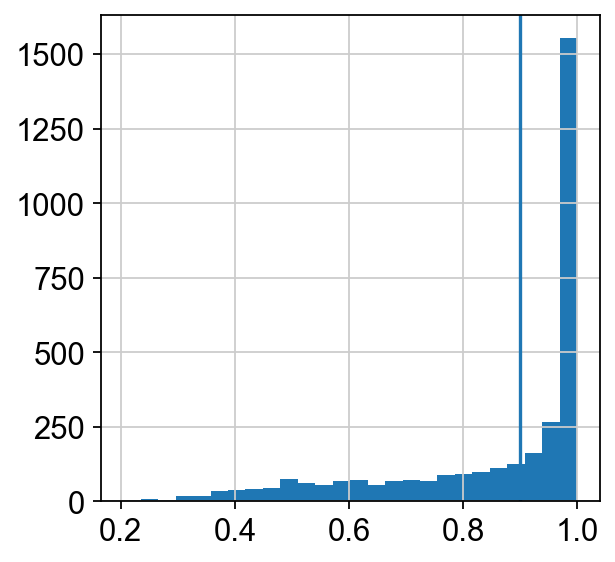

In [145]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [146]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.2-0.6,0.20410,0.59970
1,0.6-0.8,0.59970,0.80200
2,0.8-0.93,0.80200,0.92760
3,0.93-0.98,0.92760,0.98000
4,0.98-1.0,0.98000,0.99600
5,1.0-1.0,0.99775,0.99975


In [147]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50069/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [148]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCAAGATCGGTG-1    other
AAACCCAAGATGTTAG-1       01
AAACCCAAGCTGGTGA-1    other
AAACCCAAGTATAGGT-1    other
AAACCCACATGCCATA-1       04
                      ...  
TTTGGAGAGGCGAAGG-1       08
TTTGGAGGTAGATCGG-1       05
TTTGGAGTCTTCCGTG-1    other
TTTGGTTGTACGACAG-1    other
TTTGTTGAGGTGATAT-1       05
Name: clusterK12_stringent, Length: 3303, dtype: object

In [149]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

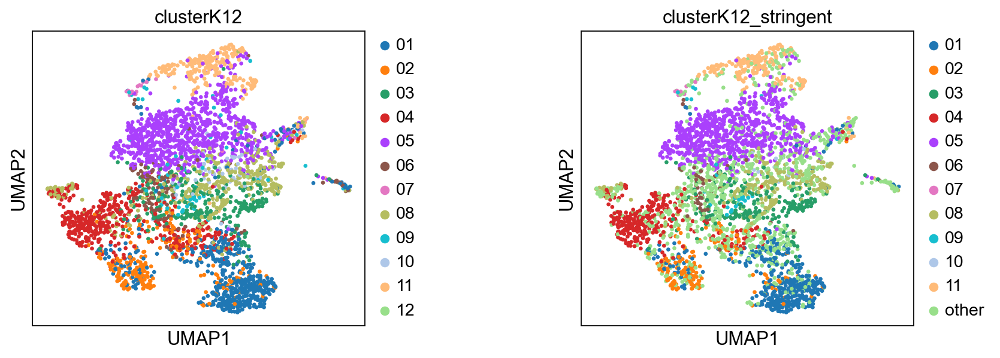

In [150]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

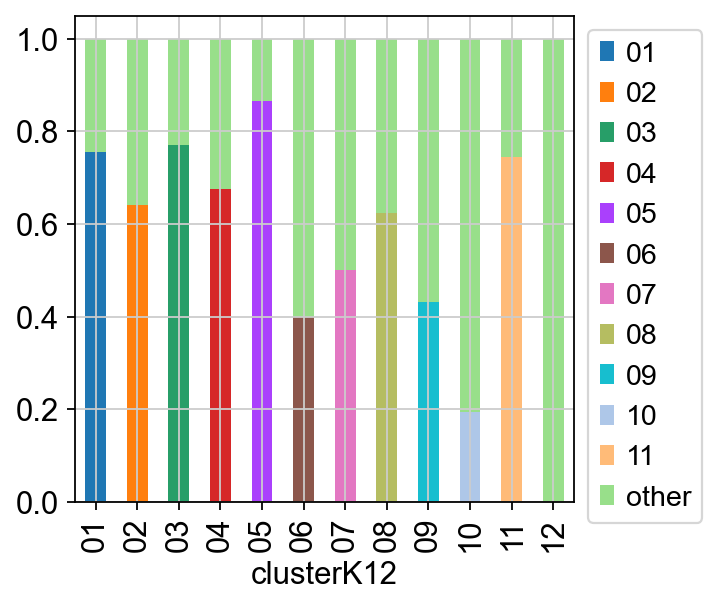

In [151]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

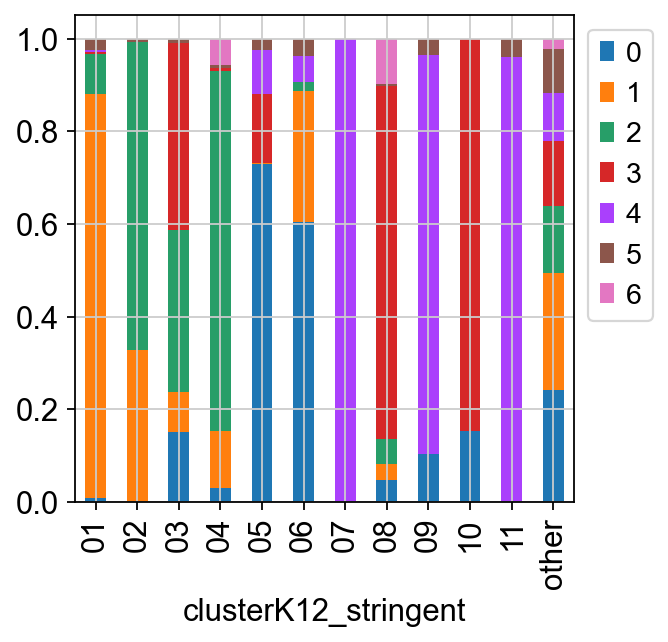

In [152]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

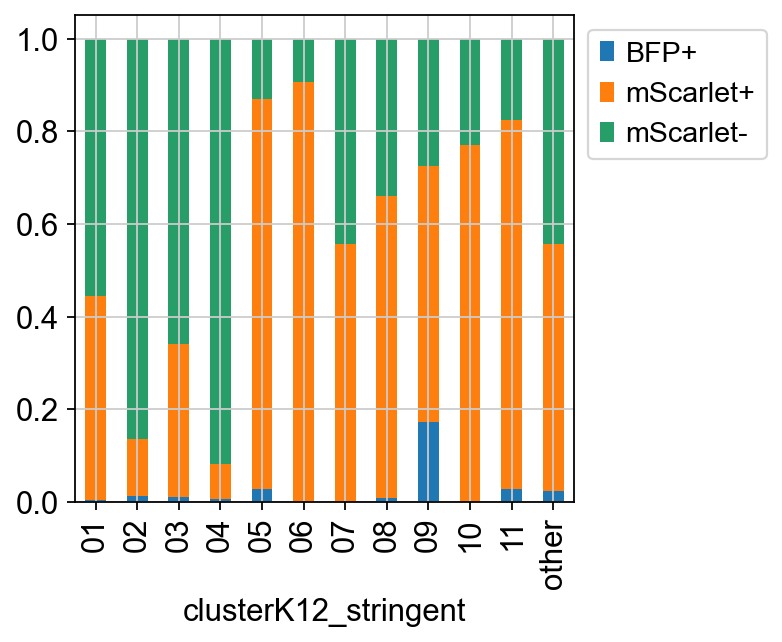

In [153]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

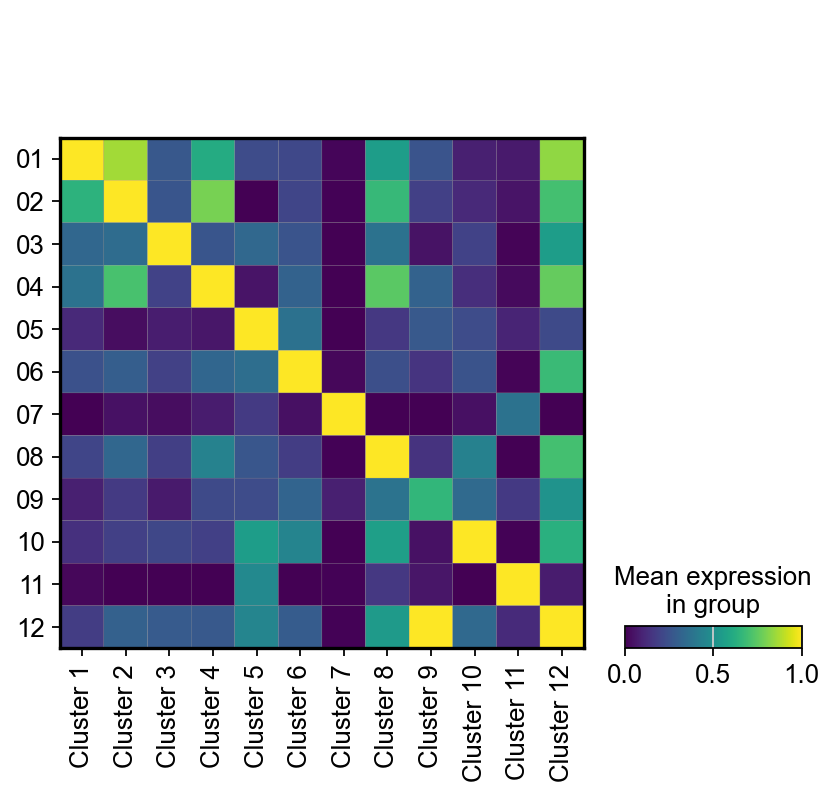

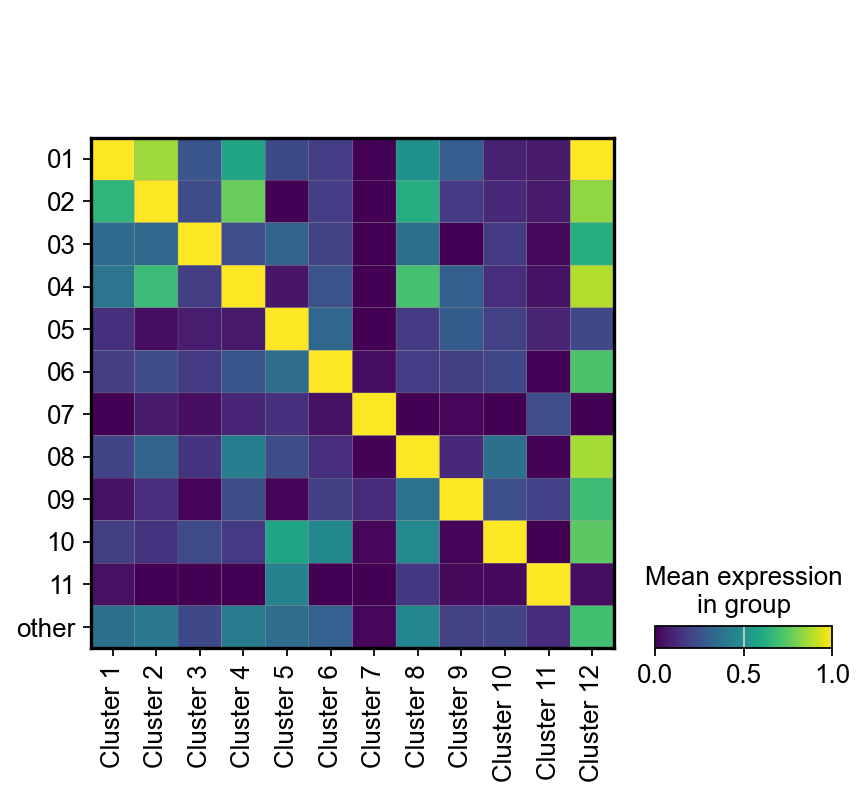

In [154]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

In [155]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']

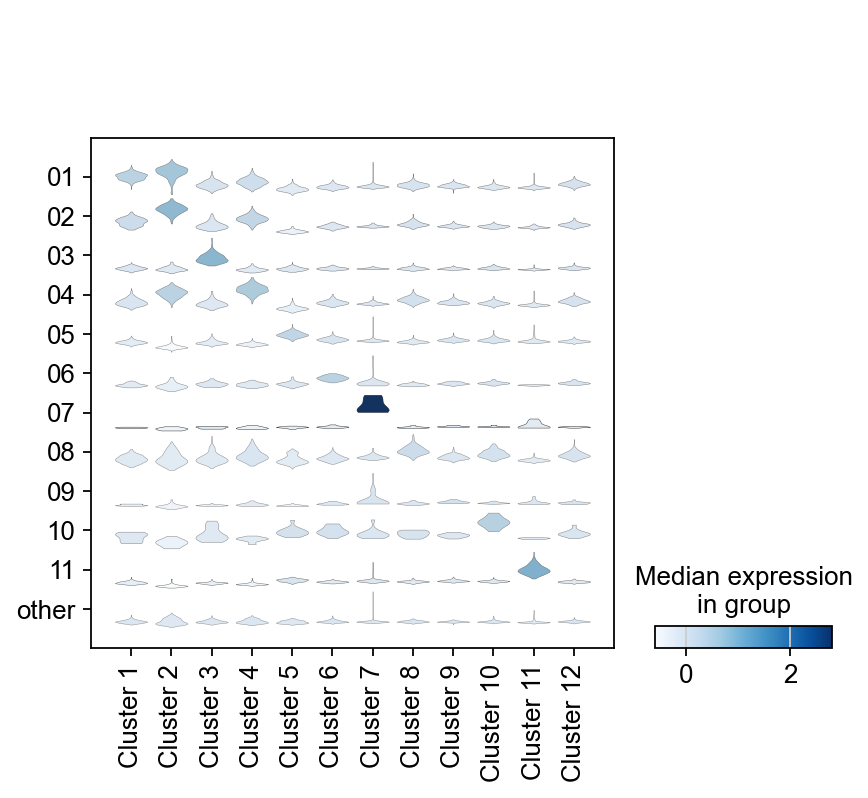

In [156]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

In [157]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

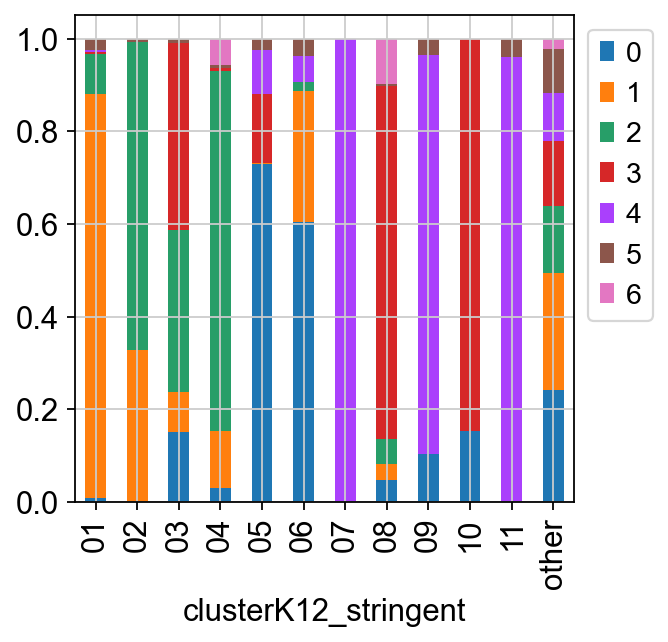

In [158]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

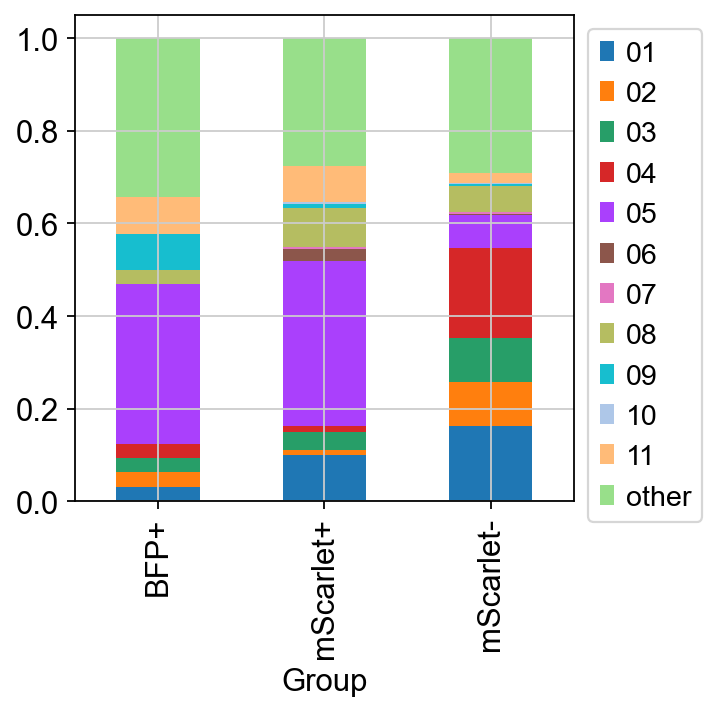

In [159]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Evaluate Leiden resolution=0.8

running Leiden clustering
    finished: found 16 clusters and added
    'newleiden', the cluster labels (adata.obs, categorical) (0:00:00)


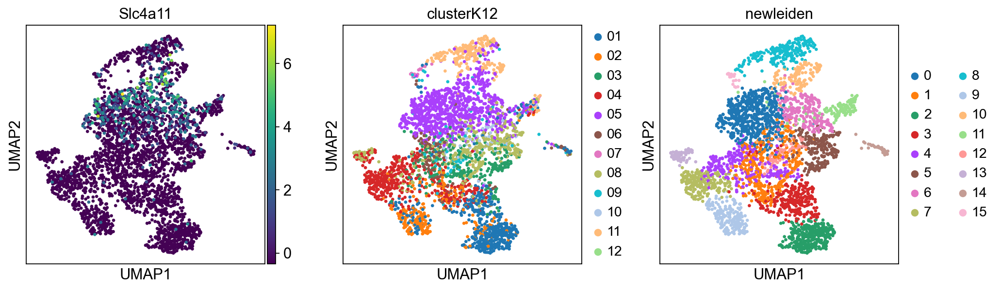

In [160]:
sc.tl.leiden(adata, resolution=.8, key_added='newleiden')
sc.pl.umap(adata, color=['Slc4a11','clusterK12','newleiden',])

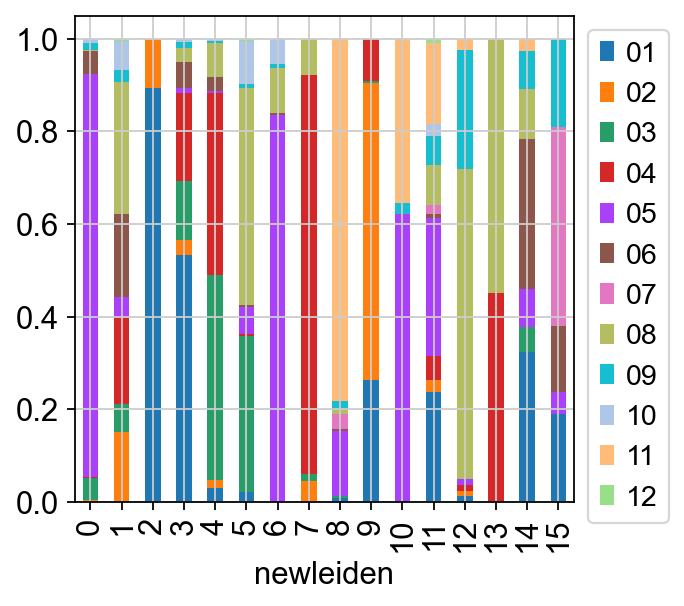

In [161]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['newleiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

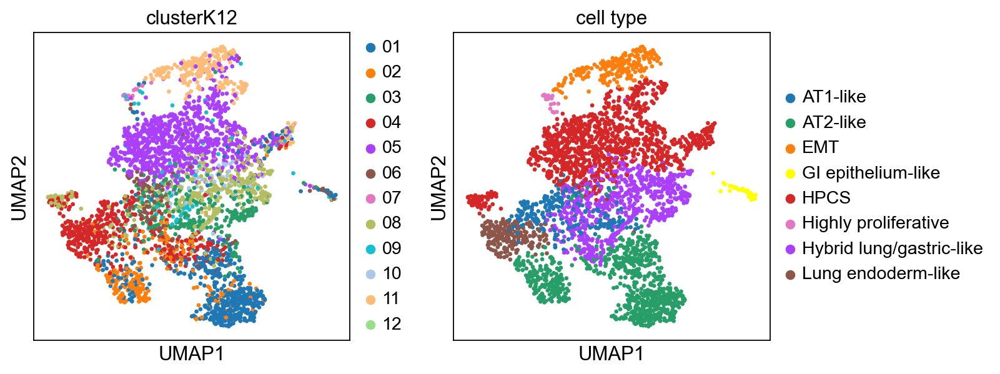

In [162]:
cluster2annotation = {
    "0": "HPCS",
    "1": "Hybrid lung/gastric-like",
    "2": "AT2-like",
    "3": "AT2-like",
    "4": "AT1-like",
    "5": "Hybrid lung/gastric-like",
    "6": "HPCS",
    "7": "Lung endoderm-like",
    "8": "EMT",
    "9": "AT2-like",
    "10": "HPCS",
    "11": "HPCS",
    "12": "Hybrid lung/gastric-like",
    "13": "HPCS",
    "14": "GI epithelium-like",
    "15": "Highly proliferative"
    
    
}
adata.obs["cell type"] = adata.obs["newleiden"].map(cluster2annotation).astype("category")
adata.obs['cell type'].cat.reorder_categories(new_categories=['AT1-like', 'AT2-like', 'EMT', 'Hybrid lung/gastric-like', 'GI epithelium-like','HPCS',
                                                              'Highly proliferative', 'Lung endoderm-like'])
adata.uns['cell type_colors'] = ['#1f77b4','#279e68','#ff7f0e', "yellow",'#d62728','#e377c2','#aa40fc','#8c564b']
sc.pl.umap(adata, color=['clusterK12','cell type',])

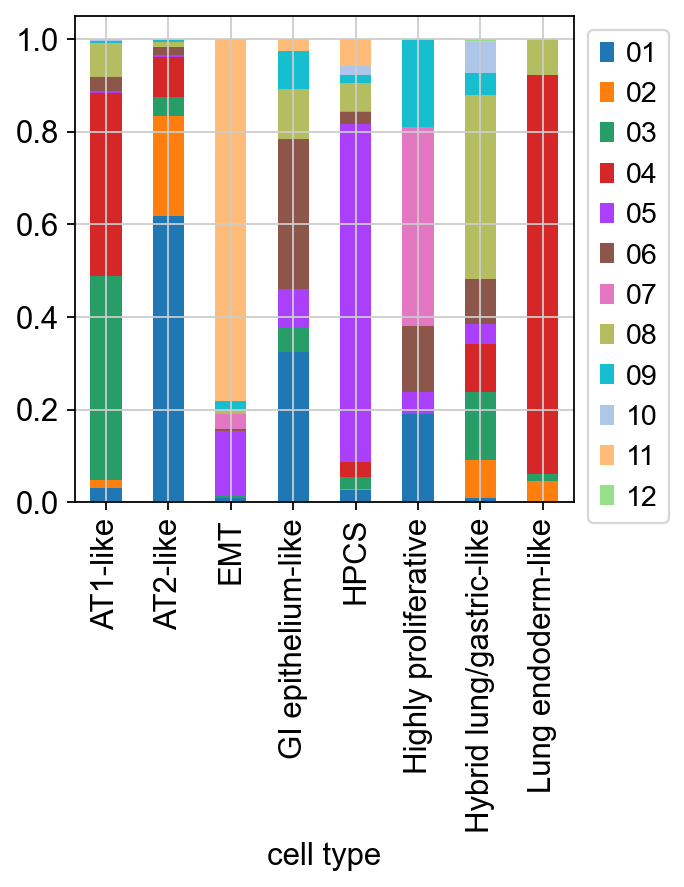

In [163]:
cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['cell type'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
#cell_proportion_df.get_figure().savefig('figures/cell_type.svg')

## Explore Phase

In [164]:
cell_cycle_genes = [x.strip() for x in open('../common_files/regev_lab_cell_cycle_genes_mouse.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [165]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    687 total control genes are used. (0:00:01)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    645 total control genes are used. (0:00:01)
-->     'phase', cell cycle phase (adata.obs)


computing PCA
    with n_comps=30
    finished (0:00:00)


/Users/chanj2/opt/miniconda3/envs/part1-cellrank/lib/python3.11/site-packages/scanpy/preprocessing/_pca/__init__.py:383: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm[key_obsm] = X_pca


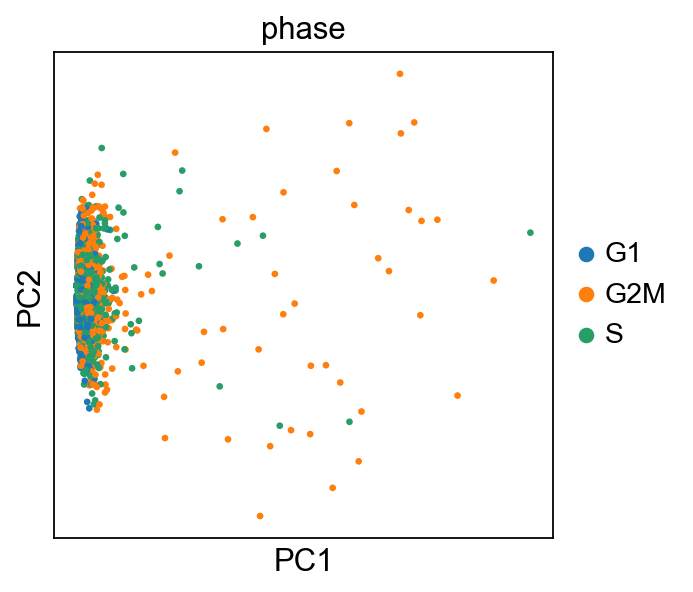

In [166]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

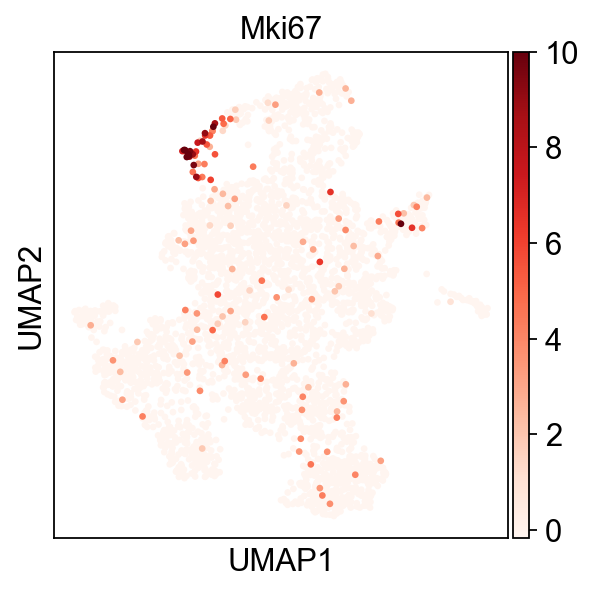

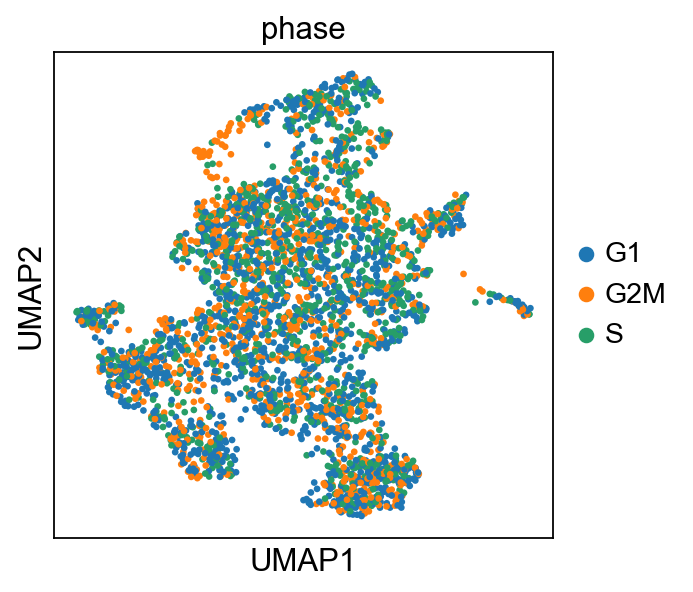

In [167]:
sc.pl.umap(adata, color=['Mki67'],cmap='Reds') #save='umap_Mki67.svg',
sc.pl.umap(adata, color=['phase']) #,save='umap_phase.svg'


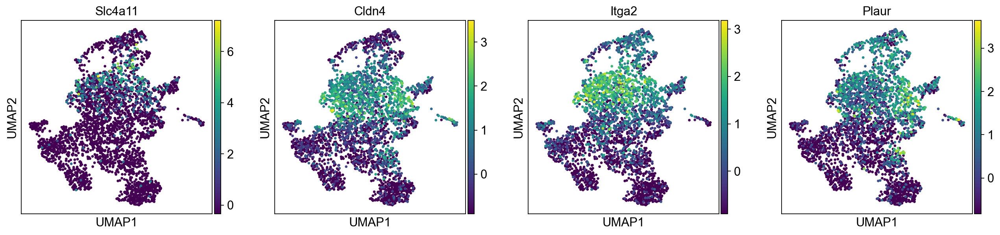

In [168]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

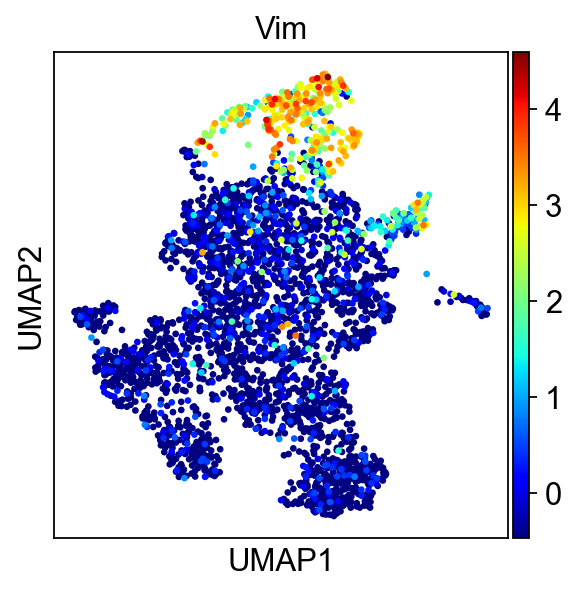

In [169]:
sc.pl.umap(adata, color=['Vim',], cmap="jet") #'Cd109'

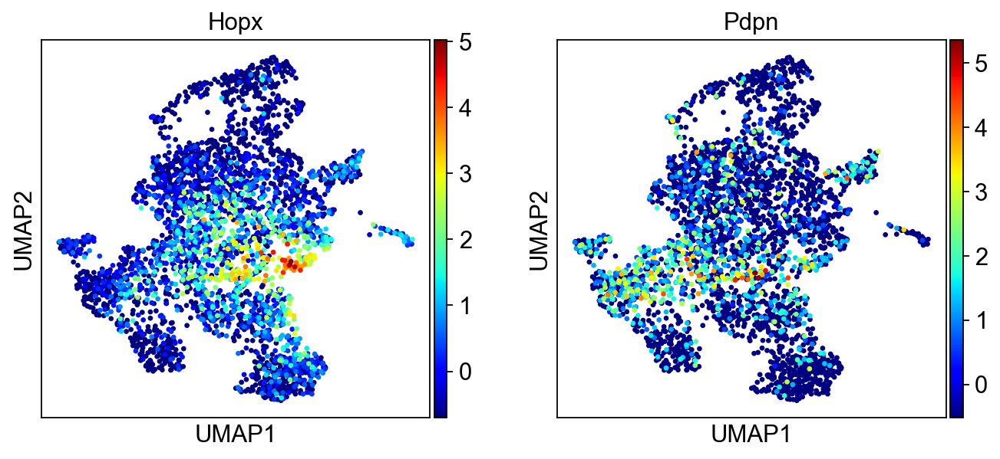

In [170]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

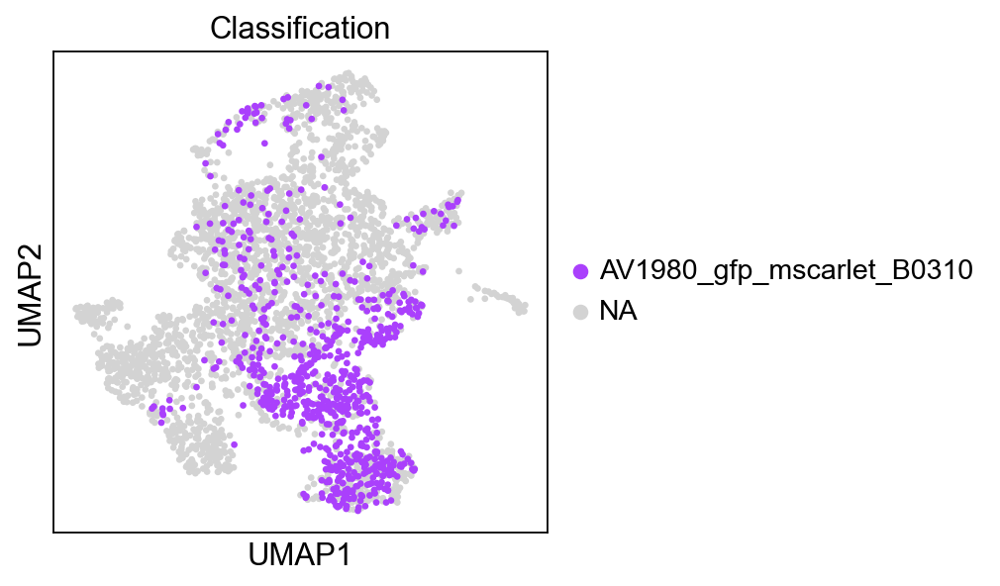

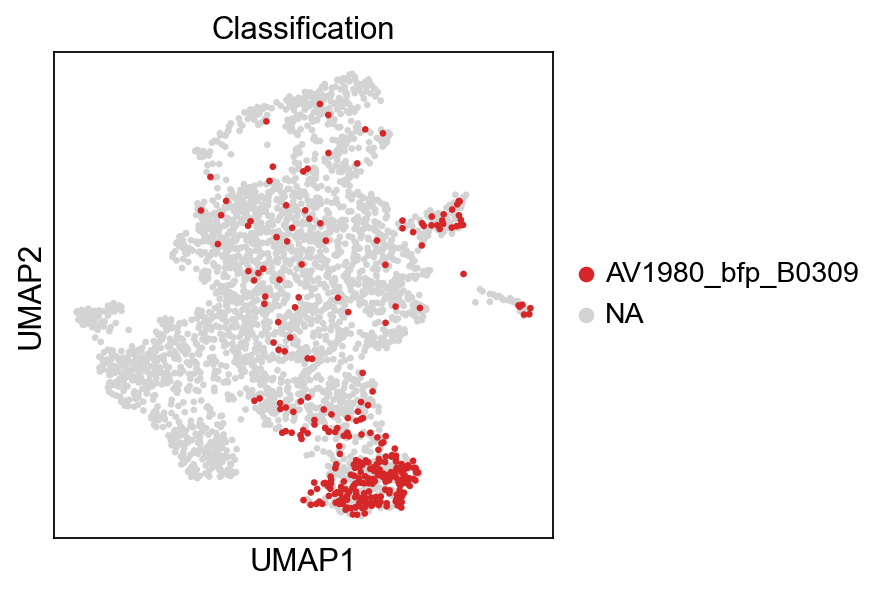

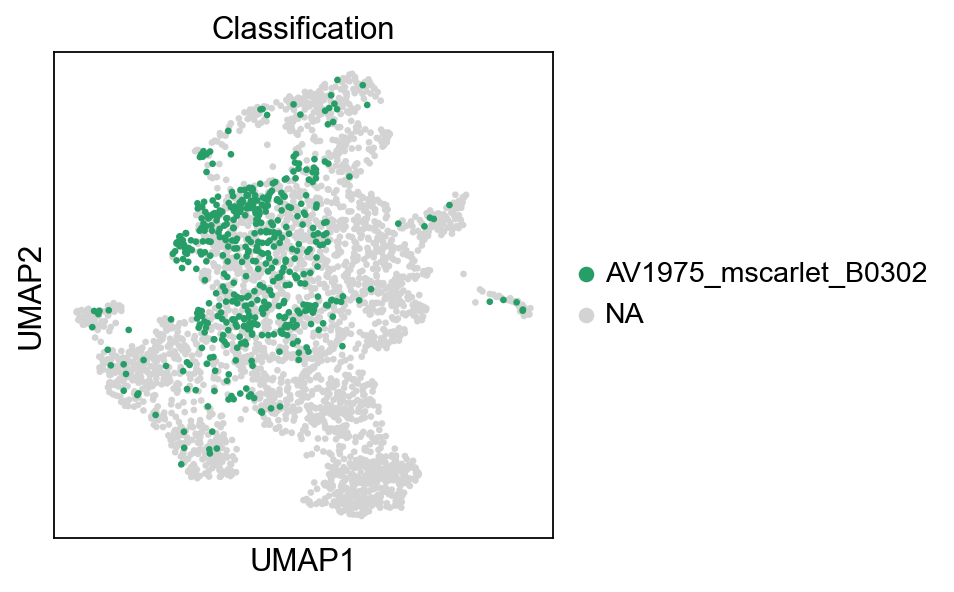

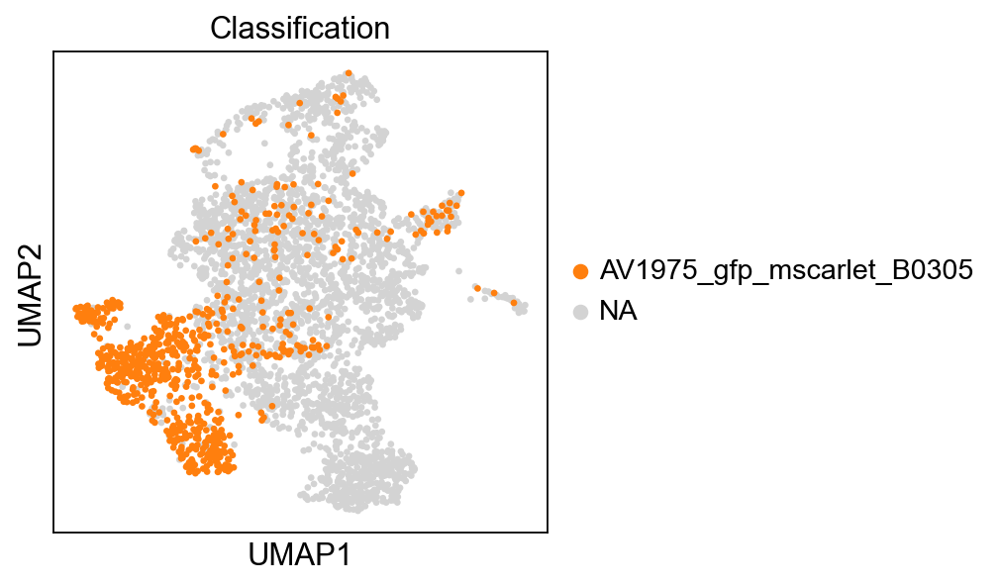

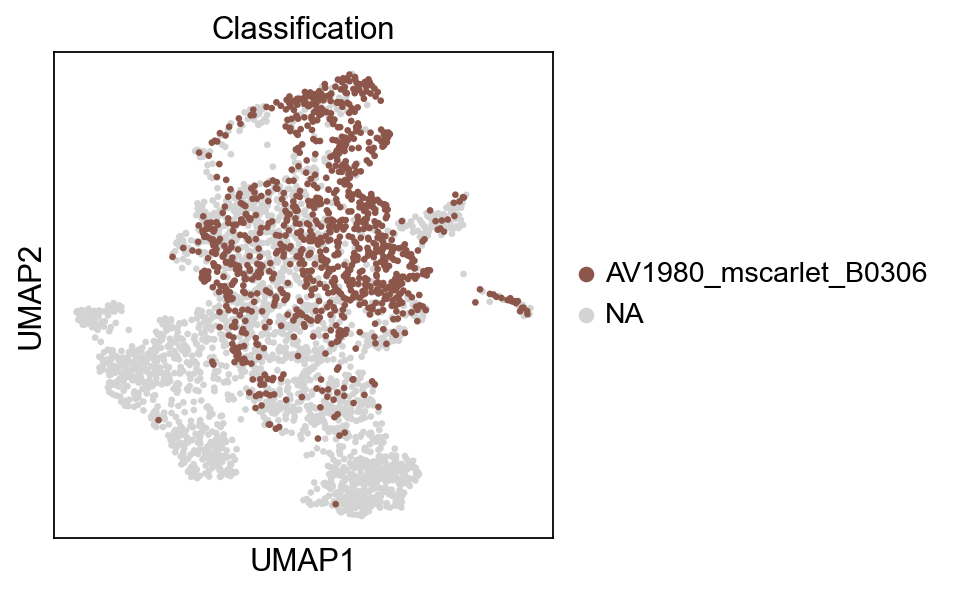

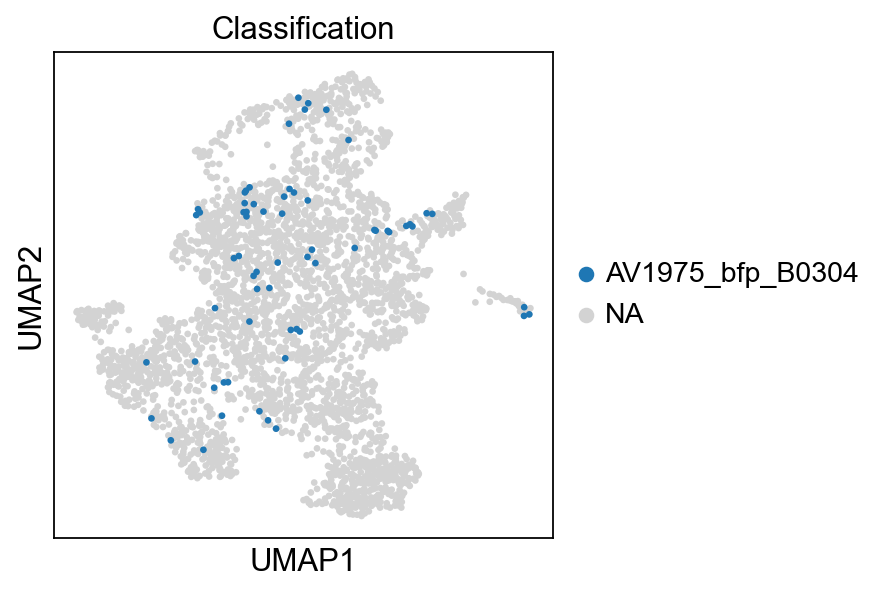

In [171]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [172]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


In [173]:
adata.obs.Group.value_counts()

Group
mScarlet+    1811
mScarlet-    1428
BFP+           64
Name: count, dtype: int64

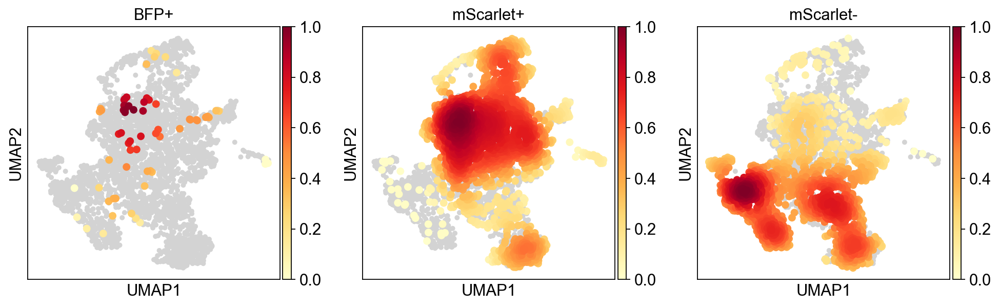

In [174]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group', )

In [175]:
adata.write(results_file, compression='gzip')

## Figures for the paper

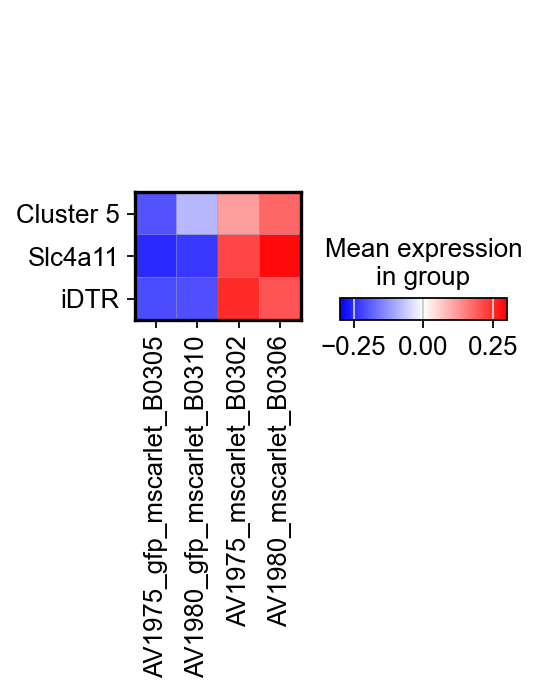

In [176]:
sc.pl.matrixplot(adata[adata.obs.Classification.isin(['AV1975_gfp_mscarlet_B0305','AV1980_gfp_mscarlet_B0310',
                                   'AV1975_mscarlet_B0302','AV1980_mscarlet_B0306']),:],
                 ['Cluster 5','Slc4a11','iDTR'],'Classification',cmap='bwr',
                 categories_order=['AV1975_gfp_mscarlet_B0305','AV1980_gfp_mscarlet_B0310',
                                   'AV1975_mscarlet_B0302','AV1980_mscarlet_B0306'],swap_axes=True,save='Fig_1h_Heatmap.svg',
                vmin=-0.3,vmax=0.3)